## Creating a Race Simulator - Part 2

In [2]:
import numpy as np
import scipy 
import scipy.stats
from scipy import stats
import seaborn as sns
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import itertools
from itertools import groupby
import pickle
import os
import math
from sympy import S, symbols
from string import digits
from numpy import *

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

plt.style.use('fivethirtyeight')
#sns.mpl.rcParams['figure.figsize'] = (16, 10)

# Directory to store pickled dataframes
directory = '/Users/dianaow/Documents/formula-1-race-data/dataframes/'

In [3]:
sns.set(rc={"font.style":"normal",
            "axes.facecolor":(0.9, 0.9, 0.9),
            "figure.facecolor":'white',
            "grid.color":'black',
            "grid.linestyle":':',
            "axes.grid":True,
            'axes.labelsize':30,
            'figure.figsize':(20.0, 15.0),
            'xtick.labelsize':20,
            'ytick.labelsize':20,
           })

current_palette = sns.color_palette("hls", 7)

In [4]:
import six

def render_mpl_table(data, col_width=2.5, row_height=0.625, font_size=22,
                     header_color='#40466e', row_colors=['#f1f1f2', 'w'], edge_color='w',
                     bbox=[0, 0, 1, 1], header_columns=0,
                     ax=None, **kwargs):
    if ax is None:
        size = (np.array(data.shape[::-1]) + np.array([0, 1])) * np.array([col_width, row_height])
        fig, ax = plt.subplots(figsize=size)
        ax.axis('off')

    mpl_table = ax.table(cellText=data.values, bbox=bbox, colLabels=data.columns, **kwargs)

    mpl_table.auto_set_font_size(False)
    mpl_table.set_fontsize(font_size)

    for k, cell in  six.iteritems(mpl_table._cells):
        cell.set_edgecolor(edge_color)
        if k[0] == 0 or k[1] < header_columns:
            cell.set_text_props(weight='bold', color='w')
            cell.set_facecolor(header_color)
        else:
            cell.set_facecolor(row_colors[k[0]%len(row_colors) ])
    return ax

In [5]:
def read_from_pickle(directory, filename):
    df = pd.DataFrame()
    filepath = directory + filename
    with open(filepath, 'rb') as file:
        df = pickle.load(file)
            
    return df

In [6]:
track_new_agg = read_from_pickle(directory, "track_new_agg.pickle")
df_tyres = read_from_pickle(directory, "df_tyres.pickle")
df_drivers = read_from_pickle(directory, "df_drivers.pickle")
df_races = read_from_pickle(directory, "df_races.pickle")
df_races_maxlaps = read_from_pickle(directory, "df_races_maxlaps.pickle")

## Compare race strategy between races 

In [7]:
def df_tyres_preprocess(df_tyres, df_races_maxlaps):
    
    df_tyre_new = pd.merge(df_tyres, df_races_maxlaps, on=['year', 'name', 'raceId'], how='left')
    
    df_tyre_new['p2'] = df_tyre_new['stint 1'] / df_tyre_new['total laps']
    df_tyre_new['p3'] = df_tyre_new['stint 2'] / df_tyre_new['total laps']
    df_tyre_new['p4'] = df_tyre_new['stint 3'] / df_tyre_new['total laps']
    df_tyre_new['p5'] = df_tyre_new['stint 4'] / df_tyre_new['total laps']
    df_tyre_new['p6'] = df_tyre_new['stint 5'] / df_tyre_new['total laps']
    df_tyre_new = df_tyre_new.drop(['stint 1', 'stint 2', 'stint 3', 'stint 4', 'stint 5', 'stint 6'], axis=1)
    
    for p in df_tyre_new[['p2', 'p3', 'p4', 'p5', 'p6']].columns:
        for i,row in df_tyre_new.iterrows():
            if (df_tyre_new.loc[i,str(p)] > 0) & (df_tyre_new.loc[i,str(p)] <= 0.2):
                df_tyre_new.loc[i,str(p)+" cat"] = 20
            elif (df_tyre_new.loc[i,str(p)] > 0.2) & (df_tyre_new.loc[i,str(p)] <= 0.4):
                df_tyre_new.loc[i,str(p)+" cat"] = 40
            elif (df_tyre_new.loc[i,str(p)] > 0.4) & (df_tyre_new.loc[i,str(p)] <= 0.6):
                df_tyre_new.loc[i,str(p)+" cat"] = 60
            elif (df_tyre_new.loc[i,str(p)] > 0.6) & (df_tyre_new.loc[i,str(p)] <= 0.8):
                df_tyre_new.loc[i,str(p)+" cat"] = 80
            elif (df_tyre_new.loc[i,str(p)] > 0.8) & (df_tyre_new.loc[i,str(p)] <= 1):
                df_tyre_new.loc[i,str(p)+" cat"] = 100
            else:
                df_tyre_new.loc[i,str(p)+" cat"] = 0

    # Drop cols related to the 5th and 6th stints
    df_tyre_new.drop(['fifth set', 'sixth set', 'p5 cat', 'p6 cat'], axis=1)
            
    return df_tyre_new

In [8]:
def find_combi(df_tyre_new):
    
    g_dup_all = pd.DataFrame()
    
    df_tyre_new['proportions'] = df_tyre_new[['p2 cat', 'p3 cat', 'p4 cat']].values.tolist()
    df_tyre_new['proportions'] = [tuple(x) for x in df_tyre_new['proportions']]
    
    df_tyre_new['tyre combi'] = df_tyre_new[['first set', 'second set', 'third set']].values.tolist()
    df_tyre_new['tyre combi'] = [tuple(x) for x in df_tyre_new['tyre combi']]
    
    df_tyre_new = df_tyre_new[['year', 'name', 'driverRef', 'proportions', 'tyre combi', 'category']].sort_values(["year", "name"])
    
    return df_tyre_new

In [9]:
df_tyres.replace("Used Super soft", "Super soft", inplace=True)
df_tyres.replace("Used Soft", "Soft", inplace=True)
df_tyres.replace("Used Ultra soft", "Ultra soft", inplace=True)
df_tyres.replace("Used Medium", "Medium", inplace=True)
df_tyres.replace("Used Wet", "Wet", inplace=True)
df_tyres.replace("Used Hard", "Hard", inplace=True)

In [10]:
df_tyre_new = df_tyres_preprocess(df_tyres, df_races_maxlaps)
df_tyre_dup_start = find_combi(df_tyre_new)

In [11]:
df_tyre_dup_start.to_pickle(os.path.join(directory,  "df_tyre_dup_start.pickle"))

In [12]:
df_tyre_dup_start = pd.merge(df_tyre_dup_start, track_new_agg[['name', 'Tyre stress', 'Number of laps']], on='name', how='left')

In [13]:
df_tyre_dup_start.groupby(['year', 'proportions', 'tyre combi']).agg({"driverRef":"count"}) \
                   .reset_index().sort_values("driverRef", ascending=False).head(10)

,year,proportions,tyre combi,driverRef
496,2017,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",36
493,2017,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",29
467,2017,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",21
336,2016,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",18
359,2017,"(0.0, 0.0, 0.0)","(Super soft, None, None)",16
3,2015,"(0.0, 0.0, 0.0)","(None, None, None)",16
110,2015,"(40.0, 40.0, 60.0)","(Soft, Soft, Medium)",15
468,2017,"(40.0, 80.0, 0.0)","(Ultra soft, Soft, None)",14
137,2015,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",13
135,2015,"(60.0, 60.0, 0.0)","(Soft, Medium, None)",13


In [14]:
SSS4080 = df_tyre_dup_start[(df_tyre_dup_start['tyre combi'] == ("Super soft", "Soft", "None")) & \
                            (df_tyre_dup_start['proportions'] == (40.0, 80.0, 0.0))]

In [15]:
# Super soft tyres for stint 1 can be compared between 2016's RUS GP and 2017's Italian and Japanese GP
# However, Safety car appeared on the first stint in 2016 RUS GP.
SSS4080

,year,name,driverRef,proportions,tyre combi,category,Tyre stress,Number of laps
41,2015,Austrian Grand Prix,verstappen,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
44,2015,Austrian Grand Prix,hulkenberg,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
54,2015,Austrian Grand Prix,bottas,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
141,2015,Canadian Grand Prix,ricciardo,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,70.0
144,2015,Canadian Grand Prix,perez,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,70.0
156,2015,Canadian Grand Prix,maldonado,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,70.0
286,2015,Monaco Grand Prix,grosjean,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",78,1.0,78.0
290,2015,Monaco Grand Prix,kvyat,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",78,1.0,78.0
303,2015,Russian Grand Prix,perez,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>50 & <= 55,2.0,53.0
311,2015,Russian Grand Prix,button,"(40.0, 80.0, 0.0)","(Super soft, Soft, None)",>50 & <= 55,2.0,53.0


In [16]:
USS6060 = df_tyre_dup_start[(df_tyre_dup_start['tyre combi'] == ("Ultra soft", "Super soft", "None")) & \
                            (df_tyre_dup_start['proportions'] == (60.0, 60.0, 0.0))]

USS6060

,year,name,driverRef,proportions,tyre combi,category,Tyre stress,Number of laps
816,2017,Abu Dhabi Grand Prix,hamilton,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>50 & <= 55,2.0,55.0
826,2017,Abu Dhabi Grand Prix,ocon,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>50 & <= 55,2.0,55.0
835,2017,Abu Dhabi Grand Prix,gasly,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>50 & <= 55,2.0,55.0
838,2017,Australian Grand Prix,verstappen,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>55 & <= 61,1.0,58.0
857,2017,Austrian Grand Prix,vettel,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0
859,2017,Austrian Grand Prix,ricciardo,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0
862,2017,Austrian Grand Prix,perez,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0
865,2017,Austrian Grand Prix,grosjean,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0
868,2017,Austrian Grand Prix,ericsson,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0
872,2017,Austrian Grand Prix,bottas,"(60.0, 60.0, 0.0)","(Ultra soft, Super soft, None)",>=70 & <= 71,2.0,71.0


In [17]:
# 2017 HUN GP can be compared with 2015's AUS GP
SSS6060 = df_tyre_dup_start[(df_tyre_dup_start['tyre combi'] == ("Super soft", "Soft", "None")) & \
                            (df_tyre_dup_start['proportions'] == (60.0, 60.0, 0.0))]
SSS6060

,year,name,driverRef,proportions,tyre combi,category,Tyre stress,Number of laps
38,2015,Austrian Grand Prix,hamilton,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
39,2015,Austrian Grand Prix,rosberg,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
40,2015,Austrian Grand Prix,vettel,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
46,2015,Austrian Grand Prix,massa,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
56,2015,Austrian Grand Prix,merhi,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,71.0
137,2015,Canadian Grand Prix,hamilton,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,70.0
138,2015,Canadian Grand Prix,rosberg,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",>=70 & <= 71,2.0,70.0
277,2015,Monaco Grand Prix,rosberg,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",78,1.0,78.0
278,2015,Monaco Grand Prix,vettel,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",78,1.0,78.0
281,2015,Monaco Grand Prix,raikkonen,"(60.0, 60.0, 0.0)","(Super soft, Soft, None)",78,1.0,78.0


## 2) Derive stint length ratios 

In [18]:
def calculate_tyre_degration_multipler(df, groupby_field):
    
    tyre_short = {"Hard": "H", "Intermediate":"I", "Medium":"M", "Soft":"S", 
          "Super soft":"SS", "Ultra soft": "US", "Wet": "W"
         }
 
    df_new = df.groupby(groupby_field)['value'].agg(['mean']).reset_index()
    df_overall = df.groupby(groupby_field[-1])['value'].agg(['mean']).reset_index()
    
    df_overall.rename(columns={'mean': 'mean (overall)'}, inplace=True)
    w_stint_mean = pd.merge(df_new, df_overall, on=groupby_field[-1], how='left')
    w_stint_mean['ratio'] = (w_stint_mean['mean'] / w_stint_mean['mean (overall)']).apply(lambda x: round(x,2))
    w_stint_mean['year'] = str(df.year.values[0])
    w_stint_mean['tyre_short'] = w_stint_mean['tyre']
    w_stint_mean['tyre_short'].replace(tyre_short, inplace=True)

    return w_stint_mean

### a) Stint length ratio for each driver for each tyre type (Driver-specific tyre degradation multiplier)
#### Some drivers and cars are relatively kinder on their tyres than others, but how do we quantify this? One way is to look at the average number of laps on each type of tyre across all the races in each season

In [19]:
tm_fresh_nounf = read_from_pickle(directory, "tm_fresh_nounf.pickle")

In [20]:
drivers_2017 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2017], ['driverRef', 'tyre'])
drivers_2016 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2016], ['driverRef', 'tyre'])
drivers_2015 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2015], ['driverRef', 'tyre'])

In [21]:
drivers_m = pd.concat([drivers_2015, drivers_2016, drivers_2017]) 

In [22]:
driversM = pd.pivot_table(drivers_m, index=['driverRef'], columns=['tyre_short', 'year'], values=['ratio'])
driversM.columns = ["_".join((i,j,k)) for i,j,k in driversM.columns]
driversM = driversM.reset_index()
driversM.fillna(1, inplace=True) # Drivers who have not utilized the tyre type before during the season will have null values. Fill missing values with 1

In [23]:
driversM.to_pickle(os.path.join(directory,  "driversM.pickle"))

In [24]:
driversM_trunc = driversM[['driverRef','ratio_H_2015', 'ratio_H_2016', 'ratio_M_2015', 'ratio_M_2016', 'ratio_M_2017', \
                          'ratio_S_2015', 'ratio_S_2016', 'ratio_S_2017', 'ratio_SS_2015', 'ratio_SS_2016',\
                          'ratio_SS_2017', 'ratio_US_2016', 'ratio_US_2017']]

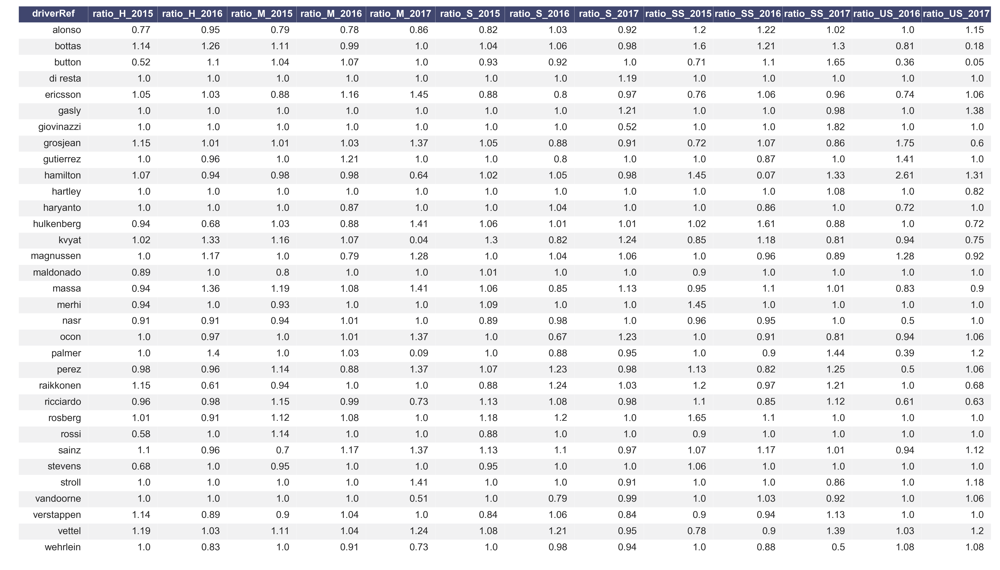

In [25]:
ax = render_mpl_table(driversM_trunc)
fig = ax.get_figure()
fig.savefig(directory + "driversM.png")

In [26]:
drivers_short = {'alonso':"ALO", 'bottas':"BOT", 'ericsson':"ERI", 'grosjean':"GRO", 'hamilton':"HAM",
                   'hulkenberg':"HUL", 'kvyat':"KVY", 'magnussen':"MAG", 'massa':"MAS", 'ocon':"OC", 'palmer':"PAL",
                   'perez':"PER", 'raikkonen':"RAI", 'ricciardo':"RIC", 'sainz':"SAI", 'stroll':"STR", 'vandoorne':"VAN",
                   'verstappen':"VER", 'vettel':"VET", 'wehrlein':"WEH"
                }
    
# Truncate to drivers who participated in more than half of the 2017 season
df_drivers_2017 = read_from_pickle(directory, "df_drivers_2017.pickle")

df_drivers_2017_trunc = list(df_drivers_2017.driverRef.unique())[:-4]
del df_drivers_2017_trunc[11]
drivers_m_17 = drivers_m[drivers_m['driverRef'].isin(df_drivers_2017_trunc)]
drivers_m_17['driverRef'].replace(drivers_short, inplace=True)

/Users/dianaow/anaconda2/lib/python2.7/site-packages/pandas/core/generic.py:3924: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


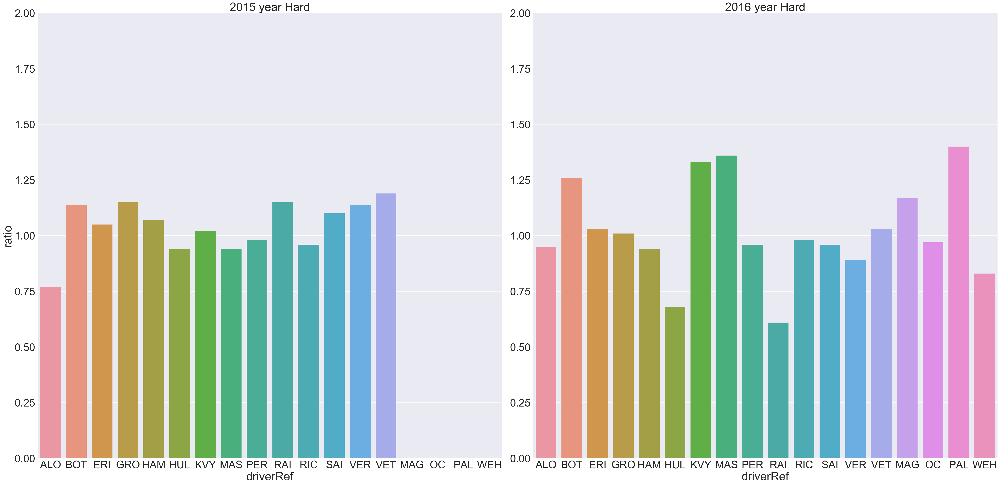

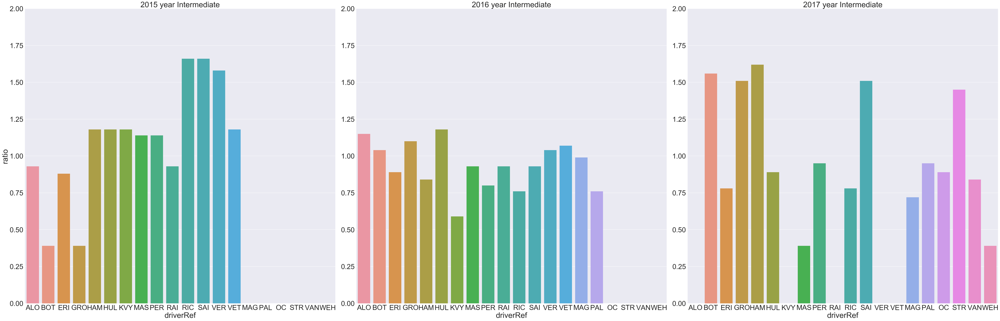

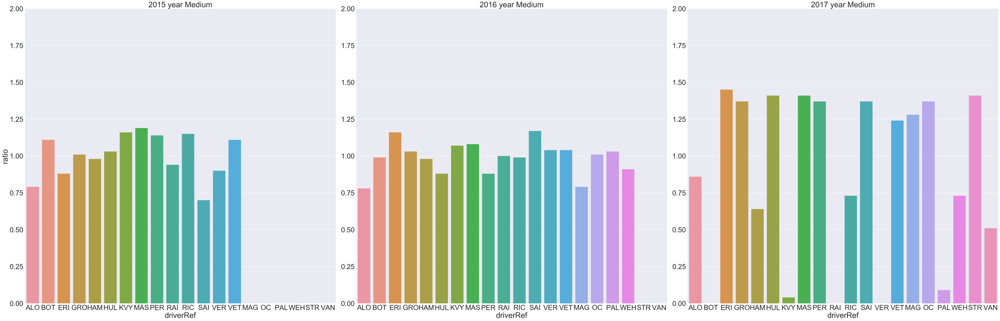

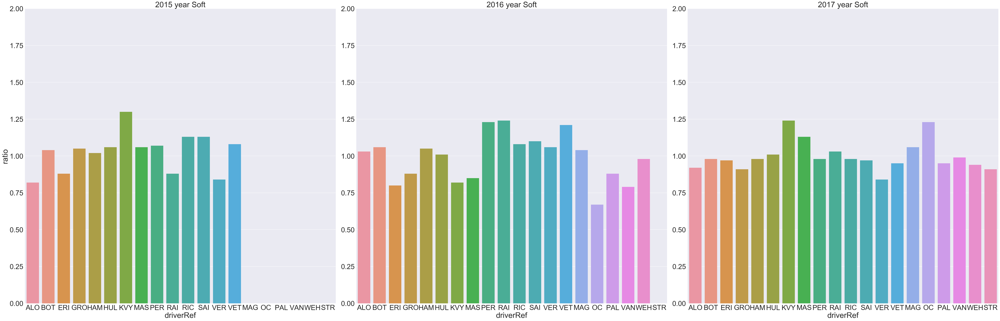

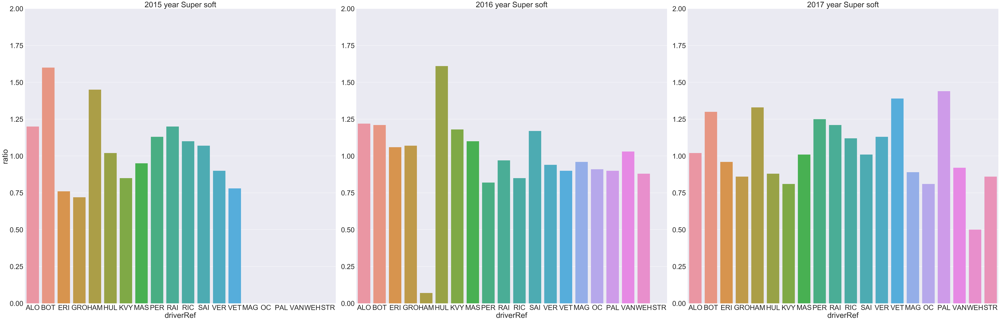

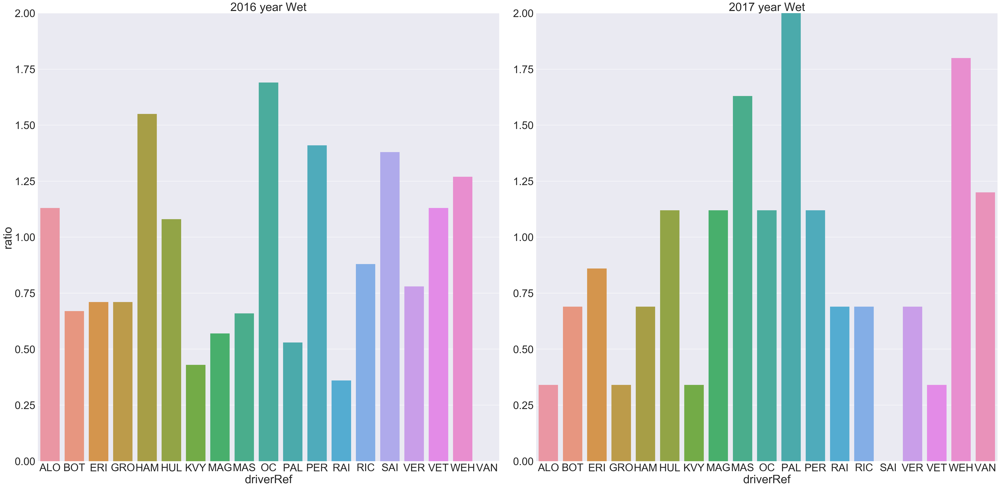

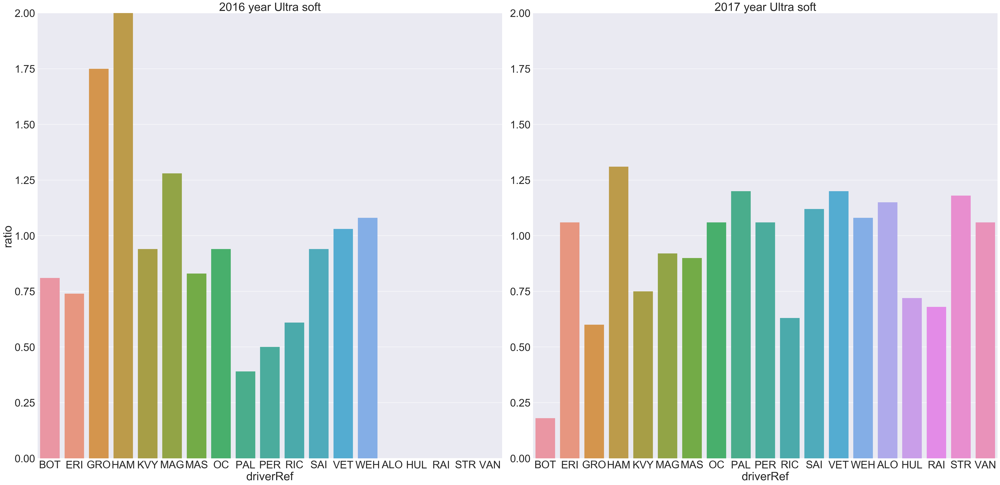

In [27]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.set(font_scale=3)

for i in drivers_m_17.tyre.unique():
    ax = sns.factorplot(x='driverRef', y="ratio", col='year', kind="bar", size= 20, data=drivers_m_17.groupby('tyre').get_group(i))
    ax.set_titles("{col_name} {col_var} " + str(i))
    ax.set(ylim=(0, 2))
    ax.savefig(directory + "driver_m" + str(i) + ".jpg") 

### Now, that the we have the tyre degradation multiplier numbers, its time to adjust the baseline tyre degradation profiles for each driver

In [28]:
TYRE_r = read_from_pickle(directory, "TYRE_r.pickle")

In [29]:
drivers_m['year'] = drivers_m['year'].astype(float)

In [30]:
drivers_m_TYRE_r = pd.merge(drivers_m, TYRE_r, on=['tyre', 'year'], how='left')

In [31]:
drivers_m_TYRE_r['x2 new'] = drivers_m_TYRE_r['x2'] / drivers_m_TYRE_r['ratio']
drivers_m_TYRE_r['x new'] = drivers_m_TYRE_r['x'] / drivers_m_TYRE_r['ratio']
drivers_m_TYRE_r['c new'] = drivers_m_TYRE_r['c'] / drivers_m_TYRE_r['ratio']

In [32]:
drivers_m_TYRE_r

,driverRef,tyre,mean,mean (overall),ratio,year,tyre_short,x2,x,c,x2 new,x new,c new
0,alonso,Hard,14.666667,19.095238,0.77,2015,H,42.970088,-735.251122,-1843.694896,55.805310,-954.871587,-2394.408956
1,alonso,Intermediate,10.666667,11.421053,0.93,2015,I,NaN,NaN,NaN,NaN,NaN,NaN
2,alonso,Medium,16.700000,21.156379,0.79,2015,M,52.102855,-992.655590,-410.916012,65.952981,-1256.526064,-520.146850
3,alonso,Soft,17.176471,21.045936,0.82,2015,S,104.031653,-2031.306435,-2163.282292,126.867870,-2477.202970,-2638.149137
4,alonso,Super soft,24.000000,20.000000,1.20,2015,SS,250.654061,-4294.964249,-1256.971903,208.878384,-3579.136874,-1047.476586
5,bottas,Hard,21.750000,19.095238,1.14,2015,H,42.970088,-735.251122,-1843.694896,37.693060,-644.957124,-1617.276224
6,bottas,Intermediate,4.500000,11.421053,0.39,2015,I,NaN,NaN,NaN,NaN,NaN,NaN
7,bottas,Medium,23.400000,21.156379,1.11,2015,M,52.102855,-992.655590,-410.916012,46.939509,-894.284316,-370.194605
8,bottas,Soft,21.900000,21.045936,1.04,2015,S,104.031653,-2031.306435,-2163.282292,100.030436,-1953.179265,-2080.079127
9,bottas,Super soft,32.000000,20.000000,1.60,2015,SS,250.654061,-4294.964249,-1256.971903,156.658788,-2684.352655,-785.607439


### While only the stint length ratio for each driver calculated in Section A will be utilized as the tyre degradation multipler in the race simulator's laptime model, Section B to E below are just further exploration of stint length ratios for different groups and levels.

### b) Stint length ratio for each driver at each race per tyre type

In [33]:
tm = read_from_pickle(directory, "tm.pickle")

In [34]:
tm.replace("Used Super soft", "Super soft", inplace=True)
tm.replace("Used Soft", "Soft", inplace=True)
tm.replace("Used Ultra soft", "Ultra soft", inplace=True)
tm.replace("Used Medium", "Medium", inplace=True)
tm.replace("Used Wet", "Wet", inplace=True)
tm.replace("Used Hard", "Hard", inplace=True)

tm = tm[tm['tyre'] != "None"]

In [35]:
def calculate_tyre_degration_multipler1(df, groupby_field):
    
    tyre_short = {"Hard": "H", "Intermediate":"I", "Medium":"M", "Soft":"S", 
          "Super soft":"SS", "Ultra soft": "US", "Wet": "W"
         }
 
    sums = df.groupby(groupby_field).agg({'value': 'sum'})
    df_new = df.set_index(groupby_field).assign(pct=sums).reset_index()
    df_new['pct'] = df_new['value'] / df_new['pct']

    df_new['year'] = str(df.year.values[0])
    df_new['tyre'].replace(tyre_short, inplace=True)

    return df_new

In [36]:
dr_2017 = calculate_tyre_degration_multipler1(tm[tm['year'] == 2017], ['driverRef', 'name', 'tyre'])
dr_2016 = calculate_tyre_degration_multipler1(tm[tm['year'] == 2016], ['driverRef', 'name', 'tyre'])
dr_2015 = calculate_tyre_degration_multipler1(tm[tm['year'] == 2015], ['driverRef', 'name', 'tyre'])

In [37]:
dr_2017[dr_2017['driverRef'] == 'perez'].sort_values('name')

,driverRef,name,tyre,year,constructorRef,value,stint,pct
119,perez,Abu Dhabi Grand Prix,US,2017,force_india,16.0,1,1.000000
498,perez,Abu Dhabi Grand Prix,SS,2017,force_india,39.0,2,1.000000
120,perez,Australian Grand Prix,US,2017,force_india,17.0,1,1.000000
499,perez,Australian Grand Prix,S,2017,force_india,40.0,2,1.000000
121,perez,Austrian Grand Prix,US,2017,force_india,35.0,1,1.000000
500,perez,Austrian Grand Prix,SS,2017,force_india,35.0,2,1.000000
122,perez,Azerbaijan Grand Prix,SS,2017,force_india,12.0,1,1.000000
792,perez,Azerbaijan Grand Prix,SS,2017,force_india,0.0,3,0.000000
501,perez,Azerbaijan Grand Prix,S,2017,force_india,8.0,2,1.000000
123,perez,Bahrain Grand Prix,SS,2017,force_india,13.0,1,0.361111


In [38]:
dr_PT_2015= pd.pivot_table(dr_2015, values='pct', index=['driverRef', 'name', 'stint'], columns=['tyre']).reset_index()
dr_PT_2015['year'] = 2015

dr_PT_2016= pd.pivot_table(dr_2016, values='pct', index=['driverRef', 'name', 'stint'], columns=['tyre']).reset_index()
dr_PT_2016['year'] = 2016

dr_PT_2017= pd.pivot_table(dr_2017, values='pct', index=['driverRef', 'name', 'stint'], columns=['tyre']).reset_index()
dr_PT_2017['year'] = 2017

dr_PT = pd.concat([dr_PT_2015, dr_PT_2016, dr_PT_2017])
dr_PT.fillna(0, inplace=True)

In [39]:
dr_PT[dr_PT['driverRef'] == 'perez'].sort_values(['year','name','stint'])

,H,I,M,S,SS,US,W,driverRef,name,stint,year
611,0.0,0.0,0.000000,0.000000,1.000000,0.000000,0.0,perez,Abu Dhabi Grand Prix,1,2015
612,0.0,0.0,0.000000,0.428571,0.000000,0.000000,0.0,perez,Abu Dhabi Grand Prix,2,2015
613,0.0,0.0,0.000000,0.571429,0.000000,0.000000,0.0,perez,Abu Dhabi Grand Prix,3,2015
614,0.0,0.0,0.655172,0.000000,0.000000,0.000000,0.0,perez,Australian Grand Prix,1,2015
615,0.0,0.0,0.344828,0.000000,0.000000,0.000000,0.0,perez,Australian Grand Prix,2,2015
616,0.0,0.0,0.000000,1.000000,0.000000,0.000000,0.0,perez,Austrian Grand Prix,1,2015
617,0.0,0.0,0.000000,0.000000,1.000000,0.000000,0.0,perez,Austrian Grand Prix,2,2015
618,0.0,0.0,0.000000,0.459459,0.000000,0.000000,0.0,perez,Bahrain Grand Prix,1,2015
619,0.0,0.0,0.000000,0.540541,0.000000,0.000000,0.0,perez,Bahrain Grand Prix,2,2015
620,0.0,0.0,1.000000,0.000000,0.000000,0.000000,0.0,perez,Bahrain Grand Prix,3,2015


In [40]:
dr_PT.to_pickle(os.path.join(directory,  "dr_PT.pickle"))

### c) Stint length ratio for each driver at each race per stint

In [41]:
def calculate_tyre_degration_multipler2(df, groupby_field):
    
 
    sums = df.groupby(groupby_field).agg({'value': 'sum'})
    df_new = df.set_index(groupby_field).assign(pct=sums).reset_index()
    df_new['pct'] = df_new['value'] / df_new['pct']

    df_new['year'] = str(df.year.values[0])

    return df_new

In [42]:
drs_2017 = calculate_tyre_degration_multipler2(tm[tm['year'] == 2017], ['driverRef', 'name'])
drs_2016 = calculate_tyre_degration_multipler2(tm[tm['year'] == 2016], ['driverRef', 'name'])
drs_2015 = calculate_tyre_degration_multipler2(tm[tm['year'] == 2015], ['driverRef', 'name'])

In [43]:
drs = pd.concat([drs_2015, drs_2016, drs_2017])
drs.fillna(0, inplace=True)

In [44]:
drs.to_pickle(os.path.join(directory,  "drs.pickle"))

In [45]:
drs_2017[drs_2017['driverRef'] == 'perez'].sort_values(['year','name','stint'])

,driverRef,name,year,constructorRef,tyre,value,stint,pct
119,perez,Abu Dhabi Grand Prix,2017,force_india,Ultra soft,16.0,1,0.290909
498,perez,Abu Dhabi Grand Prix,2017,force_india,Super soft,39.0,2,0.709091
120,perez,Australian Grand Prix,2017,force_india,Ultra soft,17.0,1,0.298246
499,perez,Australian Grand Prix,2017,force_india,Soft,40.0,2,0.701754
121,perez,Austrian Grand Prix,2017,force_india,Ultra soft,35.0,1,0.500000
500,perez,Austrian Grand Prix,2017,force_india,Super soft,35.0,2,0.500000
122,perez,Azerbaijan Grand Prix,2017,force_india,Super soft,12.0,1,0.600000
501,perez,Azerbaijan Grand Prix,2017,force_india,Soft,8.0,2,0.400000
792,perez,Azerbaijan Grand Prix,2017,force_india,Super soft,0.0,3,0.000000
123,perez,Bahrain Grand Prix,2017,force_india,Super soft,13.0,1,0.228070


In [46]:
drs.sort_values(['year','name', 'driverRef', 'stint'])

,driverRef,name,year,constructorRef,tyre,value,stint,pct
168,alonso,Abu Dhabi Grand Prix,2015,mclaren,Super soft,1.0,1,0.021277
523,alonso,Abu Dhabi Grand Prix,2015,mclaren,Soft,7.0,2,0.148936
825,alonso,Abu Dhabi Grand Prix,2015,mclaren,Soft,9.0,3,0.191489
1000,alonso,Abu Dhabi Grand Prix,2015,mclaren,Soft,30.0,4,0.638298
291,bottas,Abu Dhabi Grand Prix,2015,williams,Super soft,8.0,1,0.148148
642,bottas,Abu Dhabi Grand Prix,2015,williams,Soft,1.0,2,0.018519
913,bottas,Abu Dhabi Grand Prix,2015,williams,Soft,20.0,3,0.370370
1034,bottas,Abu Dhabi Grand Prix,2015,williams,Soft,25.0,4,0.462963
274,button,Abu Dhabi Grand Prix,2015,mclaren,Super soft,8.0,1,0.148148
625,button,Abu Dhabi Grand Prix,2015,mclaren,Soft,19.0,2,0.351852


### d) Stint length ratio for each race track
 -  Some race tracks are relatively kinder on their tyres than others, but how do we quantify this? One way is to look at the ratio of the average number of laps per stint on each type of tyre at each tack.
 - Compare this with pirelli's ranking for each tracK

In [47]:
races_2017 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2017], ['name', 'tyre'])
races_2016 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2016], ['name', 'tyre'])
races_2015 = calculate_tyre_degration_multipler(tm_fresh_nounf[tm_fresh_nounf['year'] == 2015], ['name', 'tyre'])

In [48]:
races_2016[races_2016['name'].isin(['Singapore Grand Prix', 'Belgian Grand Prix'])]

,name,tyre,mean,mean (overall),ratio,year,tyre_short
14,Belgian Grand Prix,Medium,15.789474,26.325843,0.60,2016,M
15,Belgian Grand Prix,Soft,8.416667,20.206434,0.42,2016,S
16,Belgian Grand Prix,Super soft,4.000000,14.591837,0.27,2016,SS
52,Singapore Grand Prix,Soft,20.812500,20.206434,1.03,2016,S
53,Singapore Grand Prix,Super soft,16.700000,14.591837,1.14,2016,SS
54,Singapore Grand Prix,Ultra soft,14.000000,18.000000,0.78,2016,US


In [49]:
races_m = pd.concat([races_2015, races_2016, races_2017]) 

In [50]:
racesM = pd.pivot_table(races_m, index=['name'], columns=['tyre', 'year'], values=['ratio'])
racesM.columns = ["_".join((i,j,k)) for i,j,k in racesM.columns]
racesM = racesM.reset_index()
racesM.fillna(0, inplace=True) # Races not allocated the tyre type before during the season will have null values. Fill missing values with 1

In [51]:
racesM.to_pickle(os.path.join(directory,  "racesM.pickle"))
races_m.to_pickle(os.path.join(directory,  "races_m.pickle"))

In [52]:
race_short = {'Japanese Grand Prix': "JPN", 'Malaysian Grand Prix': "MAL", 'British Grand Prix': "GB",
               'Monaco Grand Prix': "MON", 'Singapore Grand Prix': "SG",
               'Australian Grand Prix': "AU", 'Bahrain Grand Prix': "BAH", 'Belgian Grand Prix': "BEL",
               'Chinese Grand Prix': "CHN", 'Italian Grand Prix': "ITA", 'Mexican Grand Prix': "MEX",
               'Spanish Grand Prix': "ES", 'United States Grand Prix': "USA",
               'Abu Dhabi Grand Prix': "ADE", 'Azerbaijan Grand Prix': "AZE",
               'Canadian Grand Prix': "CAN", 'Russian Grand Prix': "RUS", 'Brazilian Grand Prix': "BRZ",
               'Hungarian Grand Prix': "HUN", 'Austrian Grand Prix': "AT"}

races_m['name'].replace(race_short, inplace=True)

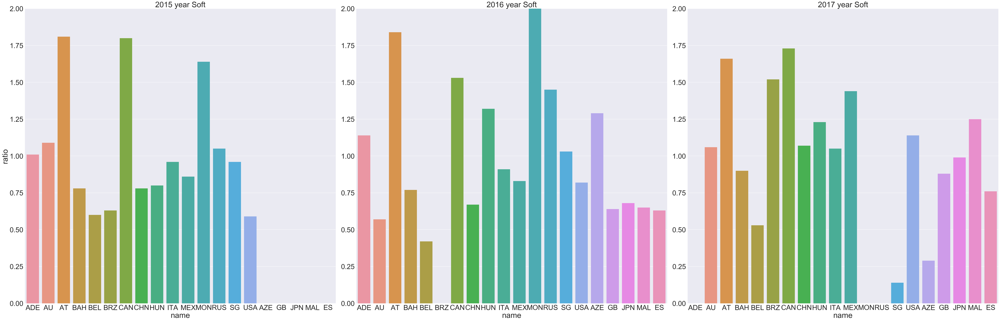

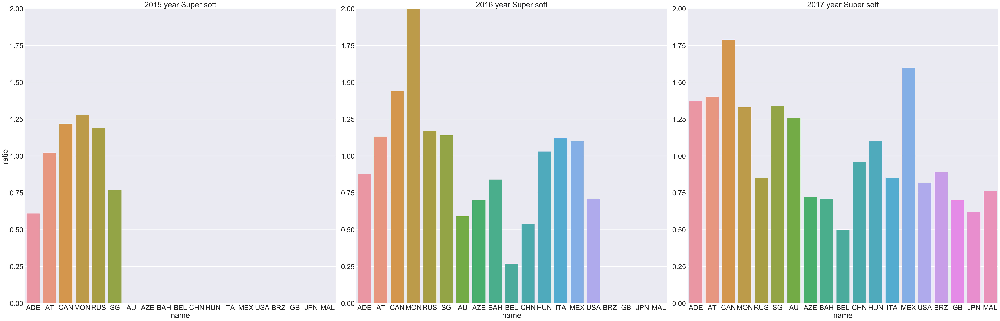

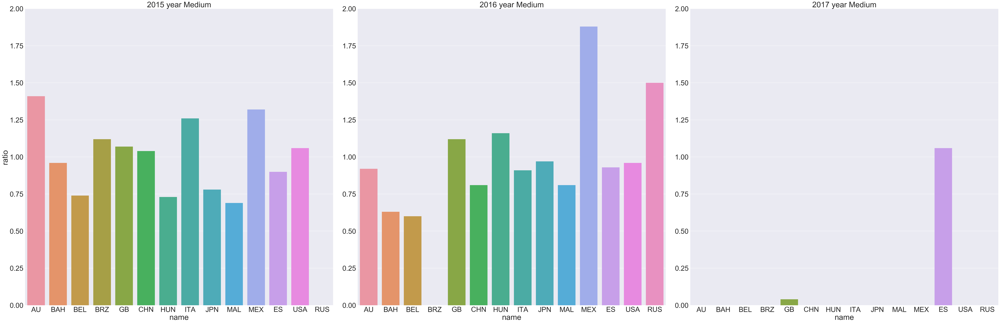

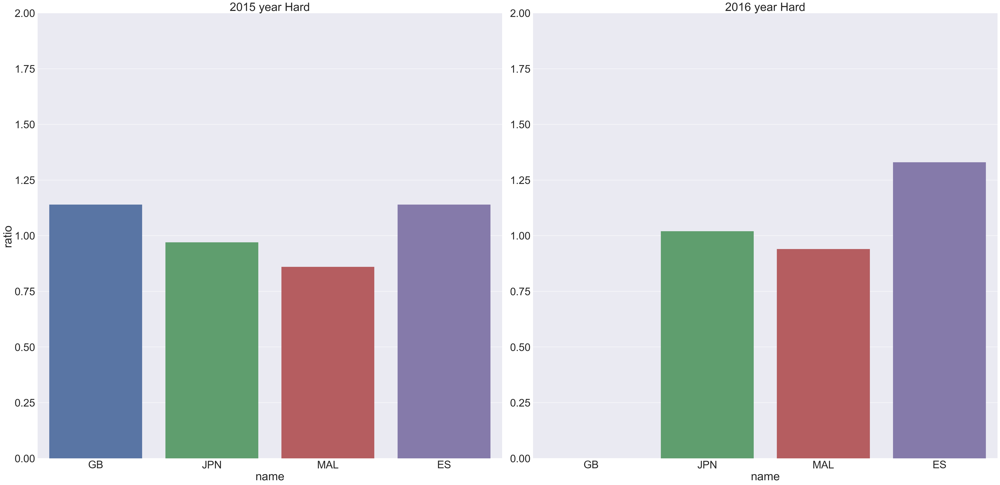

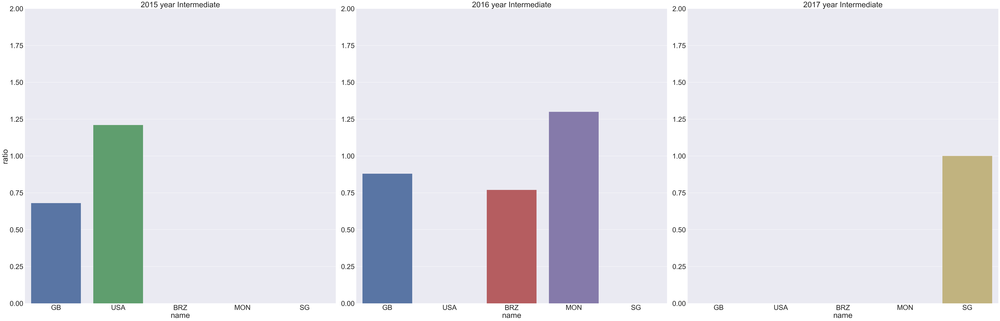

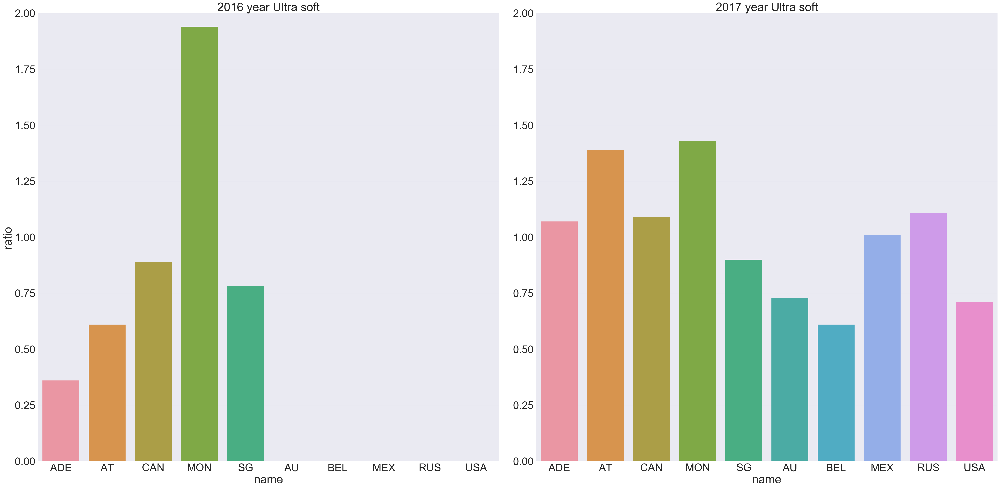

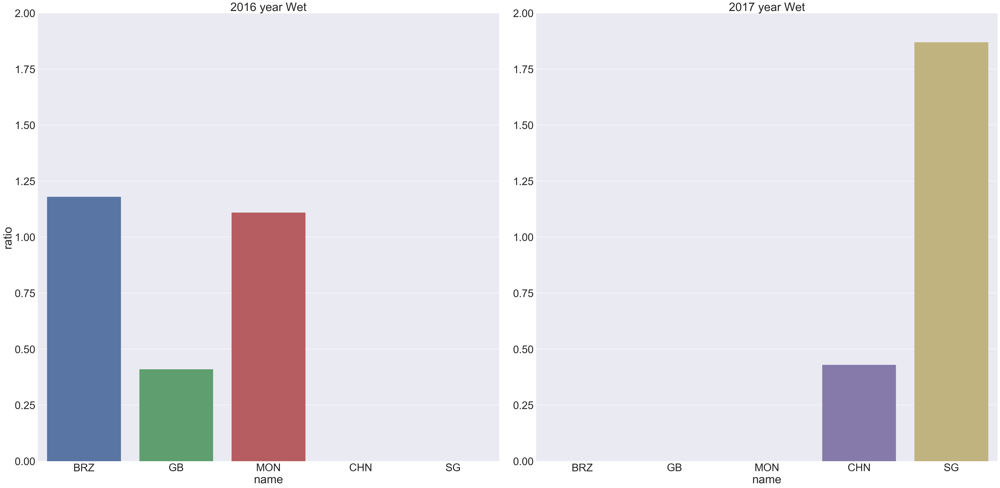

In [53]:
for i in races_m.tyre.unique():
    ax = sns.factorplot(x='name', y="ratio", col='year', kind="bar", size= 20, data=races_m.groupby('tyre').get_group(i))
    ax.set_titles("{col_name} {col_var} " + str(i))
    ax.set(ylim=(0, 2))

### e) Stint length ratio for each tyre type

In [54]:
t_2017 = tm_fresh_nounf[tm_fresh_nounf['year'] == 2017].groupby('tyre')['value'].agg(['mean']).reset_index()
t_2017['year'] = str(2017)
t_2016 = tm_fresh_nounf[tm_fresh_nounf['year'] == 2016].groupby('tyre')['value'].agg(['mean']).reset_index()
t_2016['year'] = str(2016)
t_2015 = tm_fresh_nounf[tm_fresh_nounf['year'] == 2015].groupby('tyre')['value'].agg(['mean']).reset_index()
t_2015['year'] = str(2015)

t_m = pd.concat([t_2015, t_2016, t_2017]) 

In [55]:
t_mPT = pd.pivot_table(t_m, index=['tyre'], columns=['year'], values=['mean'])
t_mPT.columns = ["_".join((i,j)) for i,j in t_mPT.columns]
t_mPT = t_mPT.reset_index()

t_m.to_pickle(os.path.join(directory,  "t_m.pickle"))
t_mPT.to_pickle(os.path.join(directory,  "t_mPT.pickle"))

In [56]:
t_mPT

,tyre,mean_2015,mean_2016,mean_2017
0,Hard,19.095238,21.367347,NaN
1,Intermediate,11.421053,11.862745,17.937500
2,Medium,21.156379,26.325843,23.388889
3,Soft,21.045936,20.206434,28.688889
4,Super soft,20.000000,14.591837,23.085470
5,Ultra soft,NaN,18.000000,22.071429
6,Wet,NaN,14.040816,5.821429


## 3) Driver-specific laptime variability

In [57]:
df_TDPS_2016_tm_fresh_nounf = read_from_pickle(directory, "df_TDPS_2016_tm_fresh_nounf.pickle")
df_TDPS_2017_tm_fresh_nounf = read_from_pickle(directory, "df_TDPS_2017_tm_fresh_nounf.pickle")

In [58]:
df_laptime_var_2016 = pd.DataFrame(df_TDPS_2016_tm_fresh_nounf.groupby(['name', 'driverRef'])['milliseconds new']\
                              .apply(lambda x: np.std(np.array(x)))).reset_index()

df_laptime_var_2017 = pd.DataFrame(df_TDPS_2017_tm_fresh_nounf.groupby(['name', 'driverRef'])['milliseconds new']\
                              .apply(lambda x: np.std(np.array(x)))).reset_index()

In [59]:
df_laptime_var_overall_2016 = pd.DataFrame(df_laptime_var_2016.groupby('driverRef')['milliseconds new']\
                              .agg('mean')).reset_index().sort_values('milliseconds new')

In [60]:
df_laptime_var_overall_2017 = pd.DataFrame(df_laptime_var_2017.groupby('driverRef')['milliseconds new']\
                              .agg('mean')).reset_index().sort_values('milliseconds new')

df_laptime_var_overall_2017_2017 = df_laptime_var_overall_2017[~df_laptime_var_overall_2017['driverRef'].isin(['button', 'giovinazzi'])]

In [61]:
df_laptime_var_overall_2016['std'] = df_laptime_var_overall_2016['milliseconds new'] / 1000
df_laptime_var_overall_2017['std'] = df_laptime_var_overall_2017['milliseconds new'] / 1000

In [62]:
df_laptime_var_overall_2017

,driverRef,milliseconds new,std
0,alonso,620.961288,0.620961
14,perez,650.596393,0.650596
19,vandoorne,708.732639,0.708733
5,giovinazzi,778.016745,0.778017
9,kvyat,780.577089,0.780577
16,ricciardo,800.845251,0.800845
15,raikkonen,828.071267,0.828071
1,bottas,954.943165,0.954943
20,verstappen,996.408471,0.996408
8,hulkenberg,1003.372905,1.003373


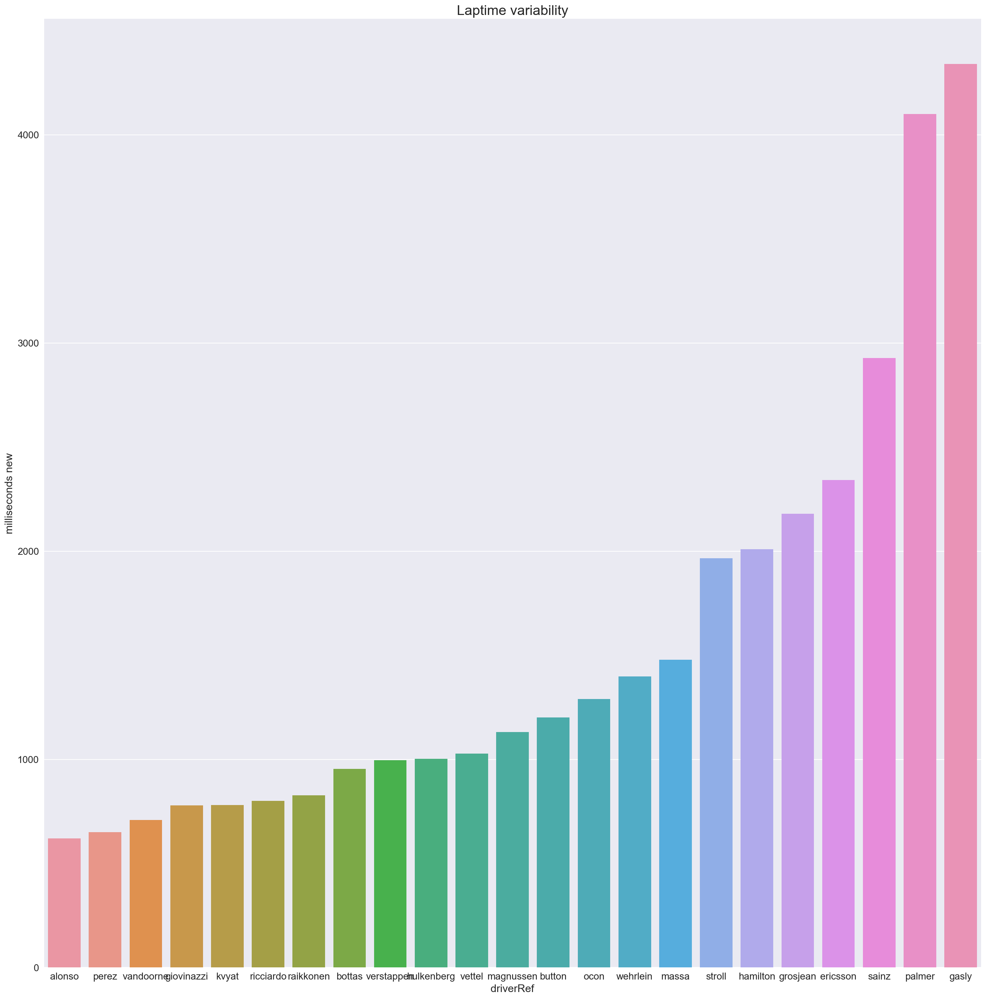

In [63]:
sns.set(font_scale=1.4)
g = sns.factorplot(x='driverRef', y="milliseconds new", kind="bar", size=20, data=df_laptime_var_overall_2017)
g.ax.set_title('Laptime variability', fontsize=20)
plt.savefig(directory + "driver_laptime_var.jpg")

In [64]:
#df_laptime_var['name_short'] = df_laptime_var['name']
#df_laptime_var['name_short'].replace(race_short, inplace=True)

In [65]:
#sns.set(font_scale=2)
#for i in df_laptime_var.driverRef.unique():
    #g = sns.factorplot(x='name_short', y="milliseconds new", kind="bar", size= 20, data=df_laptime_var.groupby('driverRef').get_group(i))
    #g.ax.set_title(str(i))

## 4) Driver's race pace estimation

#### The most important parameter for determining race results is the driver’s lap time in clean air under race conditions. An initial forecast can be obtained by studying lap times in the 1.5-hour FP2 session, when teams usually run a long stint on the tyre they intend to use for most of the race. The teams have not always finalized race set-ups at this stage, but this is the closest they come to a full race simulation. FP1 tends to involve shorter runs, while FP3 tends to have a greater focus on preparing for qualifying.

#### Summary: FREE PRACTICE 2 -> Estimate race pace

In [66]:
# FP2 2016
fp2_laptimes_pdfs = "/Users/dianaow/Documents/formula-1-race-data/PDFs/FP2/"
EXPORT_fp2_laptimes_csvs = "/Users/dianaow/Documents/formula-1-race-data/CSVs/FP2/"

In [67]:
# convert CSVs to DataFrames
def create_df_from_csvs(directory):
    
    df_concat = pd.DataFrame()
    df_filepath = [(directory + f) for f in os.listdir(directory)]

    for a in df_filepath:
        with open(a, 'rb') as file:
            try:
                df =  pd.read_csv(file, "\t", index_col=0)
                df['race'] = a.split("/")[7]
                df_concat = pd.concat([df_concat, df])
            except:
                "Cannot read csv file"

    return df_concat

In [68]:
# Clean parsed FIA table dataframes
def FIA_tables_preprocessing(df):
    
    df.columns = [x.lower() for x in df.columns]
    df['driverRef'] = [row.split('.', 1 )[1].lower() for row in df['name']]
    df['milliseconds'] = df['time'] * 1000
    df = df.drop(['name', 'time', 'driver_no'], axis=1)
    
    df['name'] = [row.split('_',2)[2].replace("_", " ").strip('.csv').title() + " Grand Prix" for row in df['race']]
    df['year'] = [row.split('_',1)[1][:4] for row in df['race']]
    df['year'] = pd.to_numeric(df['year'] , errors='coerce')

    df = df.drop(['race'], axis=1)
    
    df = pd.merge(df, df_drivers[['driverId','driverRef']], on='driverRef', how="left")
    df = pd.merge(df, df_races[['raceId','name', 'year']], on=['name', 'year'], how="left")
    df['lap'] = df.groupby(['raceId', 'driverRef']).cumcount()
    df['lap'] = map(lambda x: x + 1, df['lap'])
    
    return df

In [69]:
def filter_outliers_timediff(data, time_field='milliseconds', id_field='driverRef'):
    """Returns a logical vector corresponding to the outliers (time diff between next lap more than 1000ms) for each driver."""

    def time_diff(df):
        df['time_diff'] = df['milliseconds'].diff()
        return df

    data = data.groupby(id_field).apply(time_diff).reset_index(drop=True)
    data['time_diff'] = abs(data['time_diff'])
    data['outlier'] = (data['time_diff'] > 1000)
    data = data[data['outlier'] == False]
    data = data[data['lap'] != 1]

    return data

In [70]:
# Read in FP2 laptimes. 
df_fp2 = create_df_from_csvs(EXPORT_fp2_laptimes_csvs)
df_fp2_new = FIA_tables_preprocessing(df_fp2)

no_outliers = filter_outliers_timediff(df_fp2_new, time_field='milliseconds', id_field='driverRef')
df_forecasted_time = no_outliers.groupby(['name','driverRef']).agg({"milliseconds": 'mean'}).reset_index()
df_forecasted_time.sort_values(['name', 'milliseconds'], ascending=True)

,name,driverRef,milliseconds
7,Abu Dhabi Grand Prix,ricciardo,105919.000000
8,Abu Dhabi Grand Prix,rosberg,106242.333333
4,Abu Dhabi Grand Prix,massa,107135.800000
3,Abu Dhabi Grand Prix,kvyat27n.hulkenberg,107342.000000
6,Abu Dhabi Grand Prix,perez,107995.000000
2,Abu Dhabi Grand Prix,hamilton,108085.000000
1,Abu Dhabi Grand Prix,ericsson,108554.800000
5,Abu Dhabi Grand Prix,ocon,109561.500000
10,Abu Dhabi Grand Prix,wehrlein,109613.500000
9,Abu Dhabi Grand Prix,sainz77v.bottas,111677.142857


## Now that we have all the ingredients of the laptime model, let's test it on the 2016 season to predict laptimes of each driver and compare it to actual laptimes

#### Eg. 2016 Singapore Grand Prix

In [71]:
df_TDPS_2016 = read_from_pickle(directory, "df_TDPS_2016.pickle")

#### Generate a normally-distributed random variable with zero mean and a driver-specific standard deviation chosen as described above.

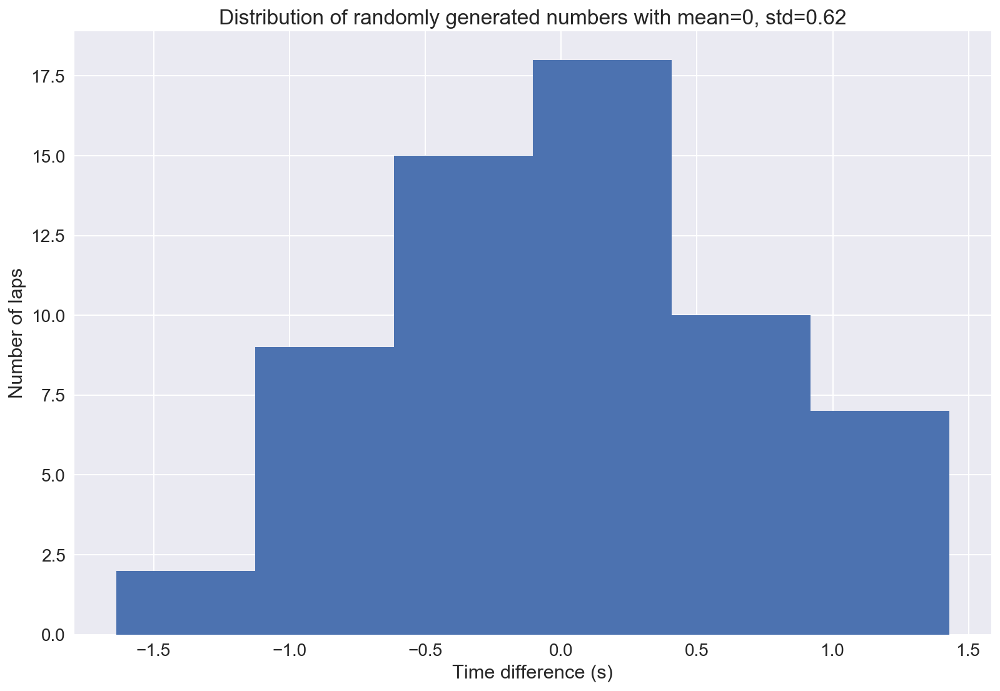

In [99]:
import scipy.stats as stats

# Example: Random number generator with mean =0 and Standard Deviation =0.62
a, b = -3, 3
mu, sigma = 0, 0.62
dist = stats.truncnorm((a - mu) / sigma, (b - mu) / sigma, loc=mu, scale=sigma)

values = dist.rvs(61)
plt.hist(values, bins = abs(a-b))

plt.title("Distribution of randomly generated numbers with mean=0, std=0.62")
plt.xlabel("Time difference (s)")
plt.ylabel("Number of laps")
plt.savefig(directory + "sample_std_graph.jpg") 

In [73]:
from random import shuffle

colors = list(matplotlib.colors.cnames.values())
colors = sort([str(c) for c in colors])
colors = colors[0:100]
shuffle(colors)
cnames_new = { x: colors[idx] for idx,x in enumerate(colors) }

class Polynomial:
    
    def __init__(self, *coefficients):
        """ input: coefficients are in the form a_n, ...a_1, a_0 
        """
        # for reasons of efficiency we save the coefficients in reverse order,
        # i.e. a_0, a_1, ... a_n
        self.coefficients = coefficients[::-1] # tuple is also turned into list
     
    # method to return the canonical string representation of a polynomial
    def __repr__(self):
        return "Polynomial" + str(self.coefficients)
    
    def __call__(self, x):    
        res = 0
        for index, coeff in enumerate(self.coefficients):
            res += coeff * x** index
        return res   

In [117]:
def plot_degradation_curves(model, actual_laptimes_g, laptime_var_g):
    
                                
    plt.figure(figsize=(20,10))
    colors = list(cnames_new.values())
                            
    a, b = -3, 3
    mu, sigma = 0, laptime_var_g['std'][0]
    dist = stats.truncnorm((a - mu) / sigma, (b - mu) / sigma, loc=mu, scale=sigma)
    
    race_laps = df_races_maxlaps[(df_races_maxlaps['year'] == int(actual_laptimes_g['year'][0])) & \
                                 (df_races_maxlaps['name'] == str(actual_laptimes_g['name'][0]))]\
                                .reset_index(drop=True)['total laps'][0]
        
    values = dist.rvs(race_laps-1)
    values = np.insert(values, 0, 0)

    for idx,row in model.iterrows():
        p = Polynomial(model.loc[idx,'x2'], model.loc[idx,'x'], model.loc[idx,'c'])
        p_adj = Polynomial(model.loc[idx,'x2 new'], model.loc[idx,'x new'], model.loc[idx,'c new'])
        X = np.linspace(0, len(actual_laptimes_g['milliseconds new']), len(actual_laptimes_g['milliseconds new']), endpoint=True)
        
        F = p(X)
        F_adj = p_adj(X)
        
        F_new = []
        F_td = []
        F_td_adj = []
        
        for i,j in zip(F, values):
            i = i- F[0] + j*1000
            F_new.append(i)
        
        for i in F:
            i = i- F[0]
            F_td.append(i)
            
        for i in F_adj:
            i = i- F_adj[0]
            F_td_adj.append(i)
        
        plt.plot(X, F_td, color='y', label=("tyre degradation profile", model['driverRef'][idx], model['tyre'][idx]), linewidth=3.0)
        plt.plot(X, F_td_adj, color='r', label=("tyre degradation profile (adj)", model['driverRef'][idx], model['tyre'][idx]), linewidth=3.0)
        plt.plot(X, F_new, color='g', label=("predicted", model['driverRef'][idx], model['tyre'][idx]), linewidth=3.0)
        plt.plot(X, actual_laptimes_g['milliseconds new'], color='b', \
                 label=("actual", actual_laptimes_g['driverRef'][idx], actual_laptimes_g['tyre'][idx], actual_laptimes_g['stint'][idx]), linewidth=3.0)

        plt.title(actual_laptimes_g['name'][idx], fontsize=30)

        plt.xlabel('lap number', fontsize=20)
        plt.ylabel('time to complete a lap (centered to zero, in milliseconds))', fontsize=18)
        plt.legend(loc='upper left', fontsize=22)
        plt.show()

#### Test the plotting function above on one scenario: Alonso on Soft tyres at the 2016 Singapore Grand Prix

In [75]:
test = drivers_m_TYRE_r[(drivers_m_TYRE_r['driverRef'] == 'alonso') & \
                        (drivers_m_TYRE_r['tyre'] == 'Soft') & \
                       (drivers_m_TYRE_r['year'] == 2016) ].reset_index(drop=True)

In [76]:
test_actual = df_TDPS_2016[(df_TDPS_2016['name'] == 'Singapore Grand Prix') & \
                           (df_TDPS_2016['driverRef'] == 'alonso') & \
                           (df_TDPS_2016['tyre'] == 'Soft') & \
                           (df_TDPS_2016['year'] == 2016) ].reset_index(drop=True)

In [78]:
test_laptime_var = df_laptime_var_overall_2016[df_laptime_var_overall_2016['driverRef'] == 'alonso'].reset_index(drop=True)

61


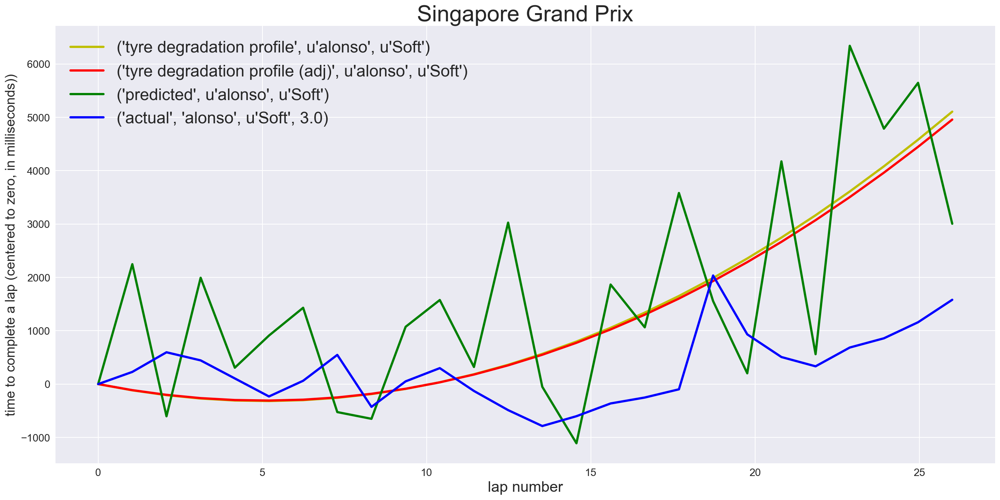

In [112]:
plot_degradation_curves(test, test_actual, test_laptime_var)

In [120]:
def plot_degradation_curves_ALL(tyre_degrad_profile, actual_laptimes, df_laptime_var_overall, **kwargs):
        
    groupby_fields = []
    values = []
    
    if kwargs is not None:
        for key, value in kwargs.iteritems():
            groupby = actual_laptimes[value].unique()
            groupby_fields.append(groupby)
            values.append(value)
            
    for g in itertools.product(*groupby_fields):
        
        try:
            tyre_degrad_profile_g = tyre_degrad_profile.groupby([values[0], values[2]]).get_group((g[0], g[2])).reset_index()
            actual_laptimes_g = actual_laptimes.groupby(values).get_group(g).reset_index()
            laptime_var_g = df_laptime_var_overall.groupby(values[0]).get_group(g[0]).reset_index()
            
            plot_degradation_curves(tyre_degrad_profile_g, actual_laptimes_g, laptime_var_g)
        except:
            "no group"

### Test the function above on the 2016 Singapore Grand Prix and 2016 Australian Grand Prix 

In [121]:
s = drivers_m_TYRE_r[(drivers_m_TYRE_r['year'] == 2016) & (drivers_m_TYRE_r['tyre'] == 'Soft')]
ss = drivers_m_TYRE_r[(drivers_m_TYRE_r['year'] == 2016) & (drivers_m_TYRE_r['tyre'] == 'Super soft')]

In [122]:
sgp_test_s = df_TDPS_2016[(df_TDPS_2016['name'].isin(['Singapore Grand Prix'])) & \
                        (df_TDPS_2016['tyre'].isin(['Soft']))]
aus_test_s = df_TDPS_2016[df_TDPS_2016['name'].isin(['Australian Grand Prix']) & \
                        (df_TDPS_2016['tyre'].isin(['Soft']))]

sgp_test_ss = df_TDPS_2016[(df_TDPS_2016['name'].isin(['Singapore Grand Prix'])) & \
                        (df_TDPS_2016['tyre'].isin(['Super soft']))]
aus_test_ss = df_TDPS_2016[df_TDPS_2016['name'].isin(['Australian Grand Prix']) & \
                        (df_TDPS_2016['tyre'].isin(['Super soft']))]

#### 2016 Singapore Grand Prix, Softs

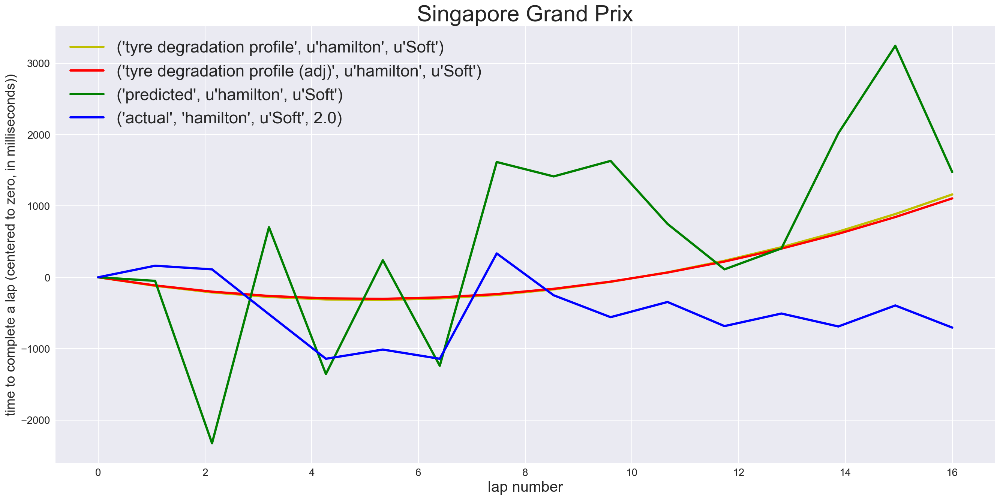

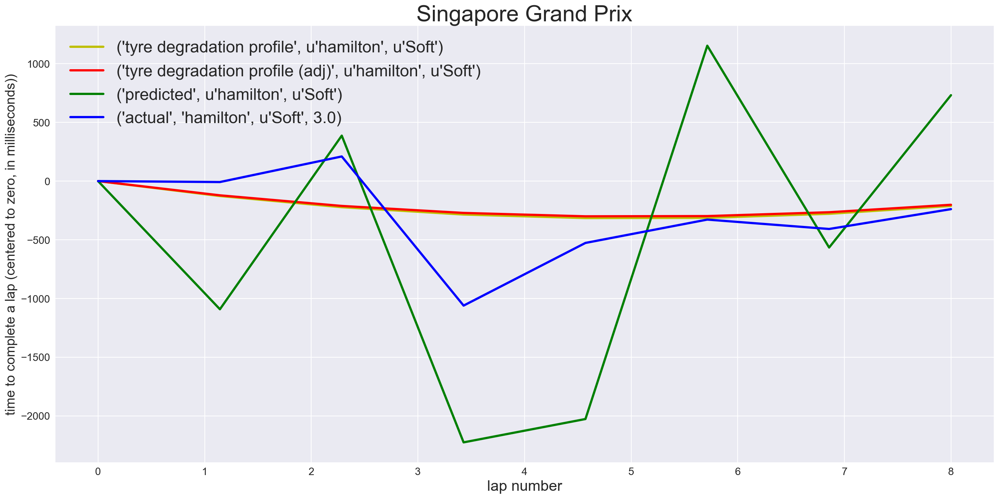

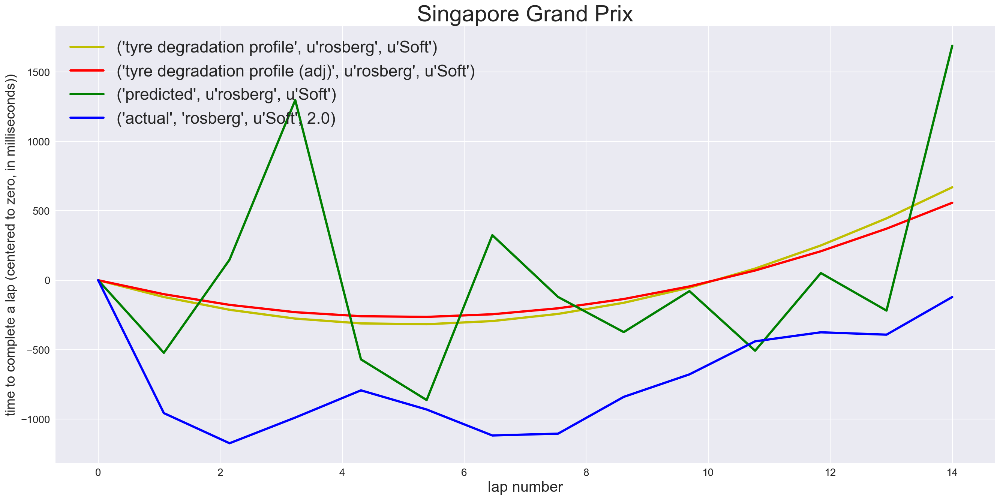

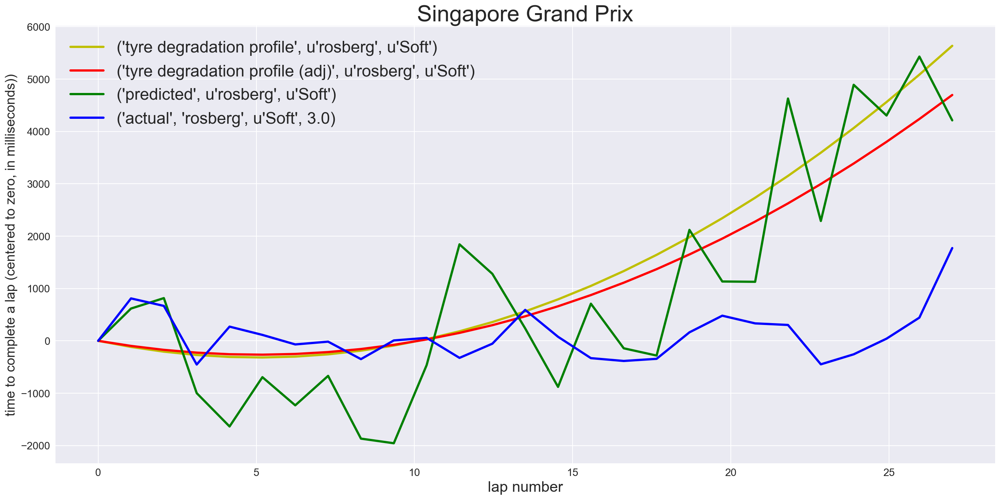

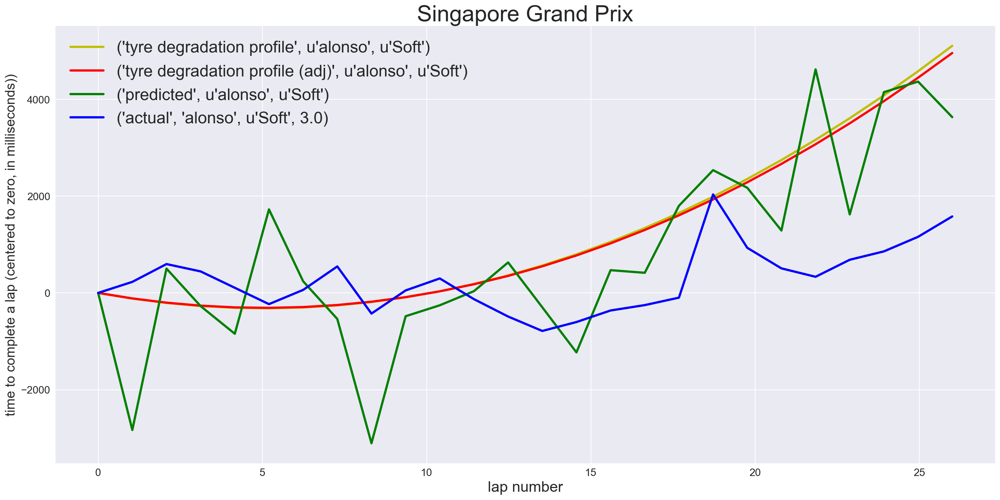

...

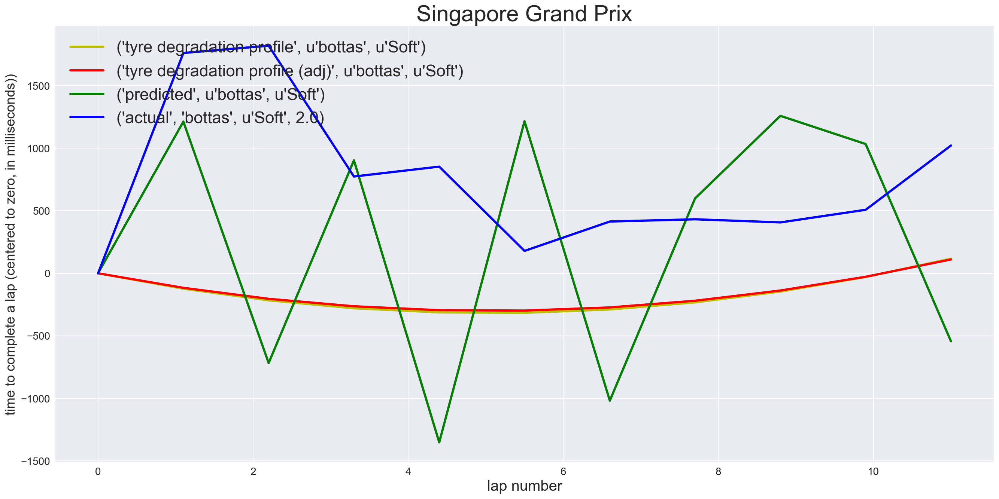

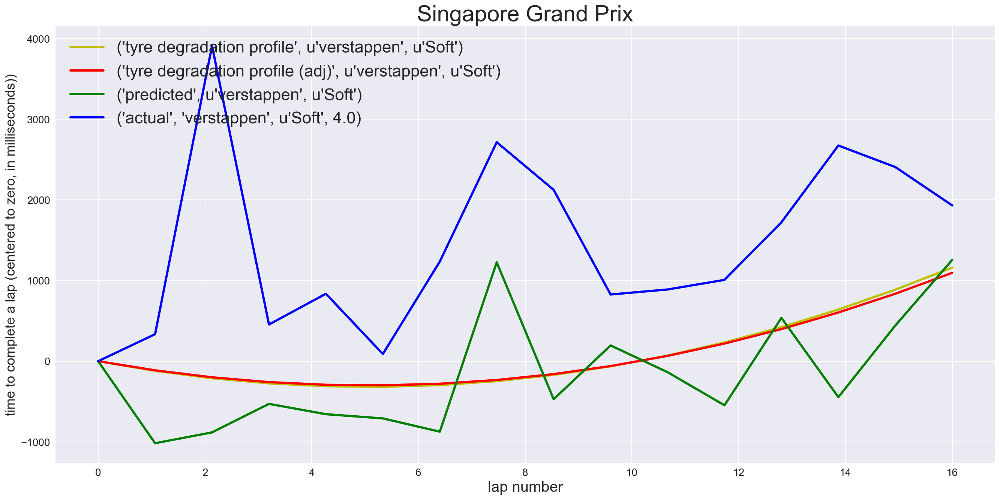

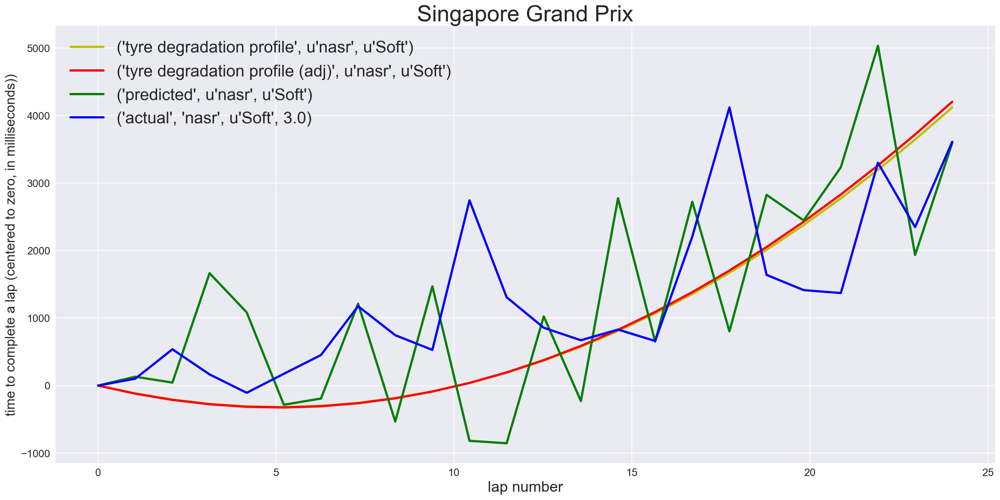

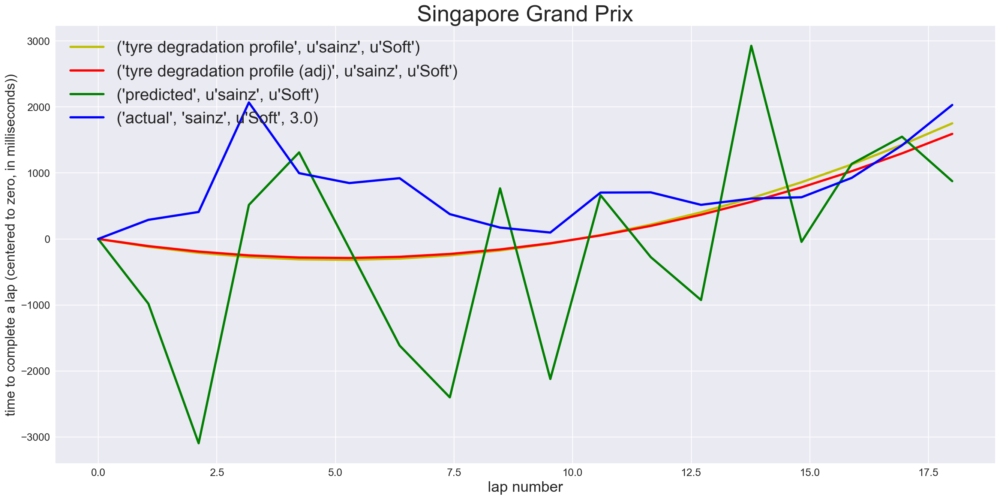

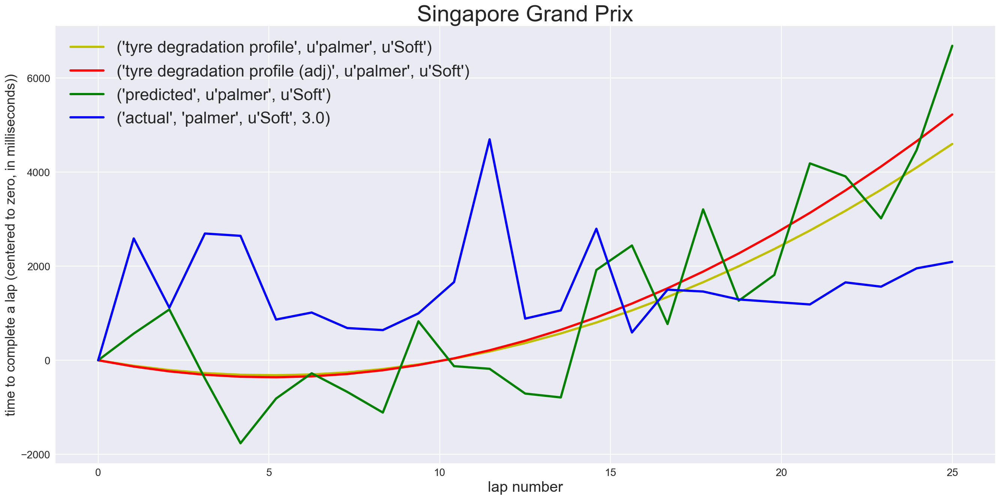

In [123]:
plot_degradation_curves_ALL(s, sgp_test_s, df_laptime_var_overall_2016,\
                            groupby_1_field='driverRef', groupby_2_field='name', groupby_3_field='tyre', groupby_4_field='stint')

#### 2016 Singapore Grand Prix, Super softs

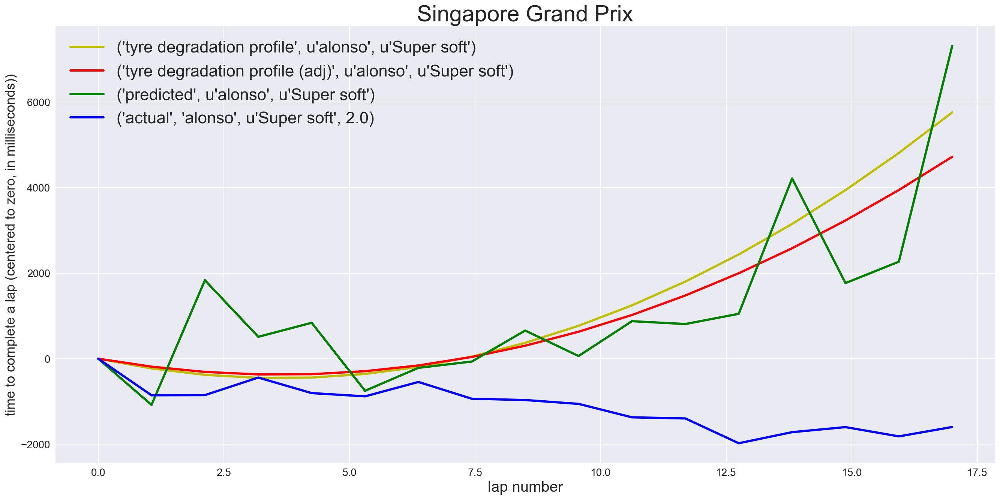

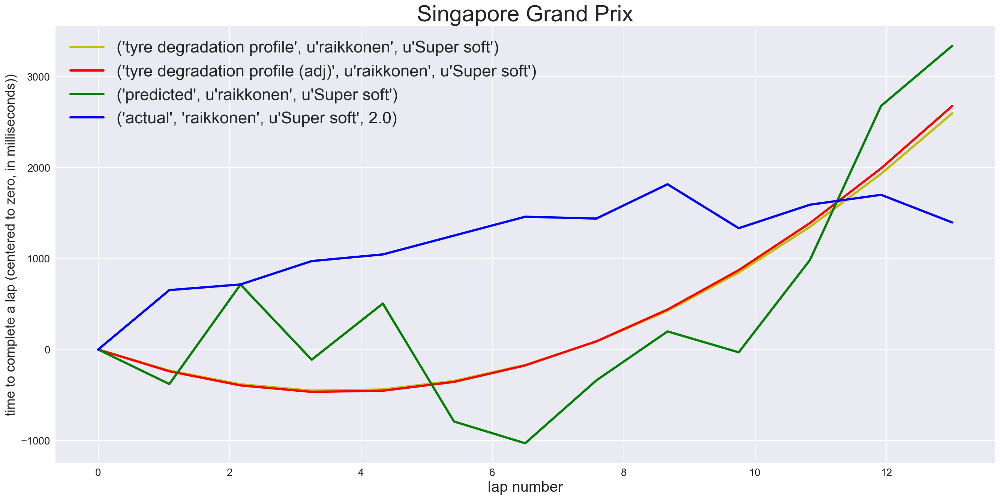

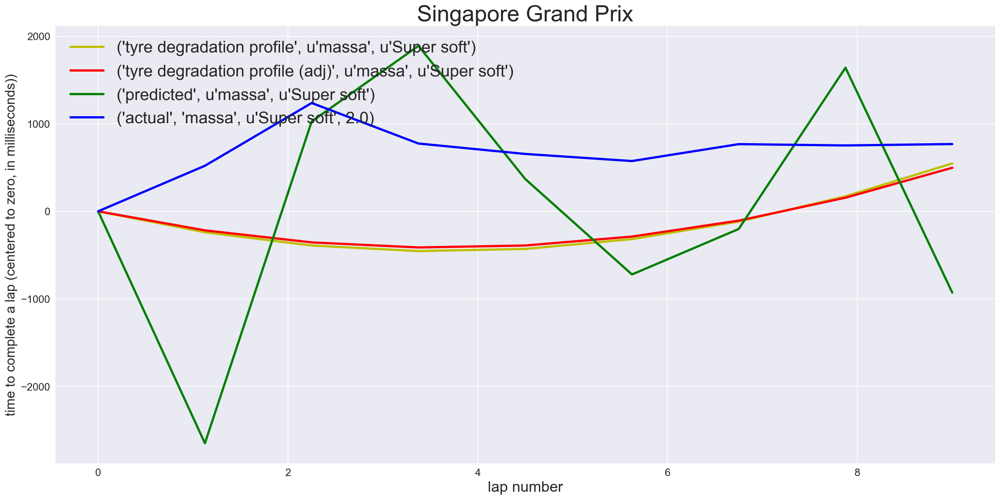

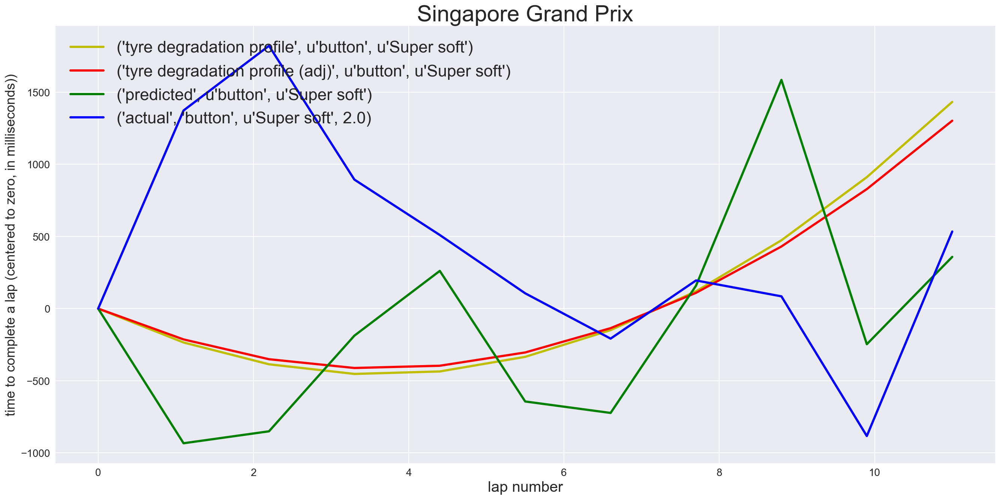

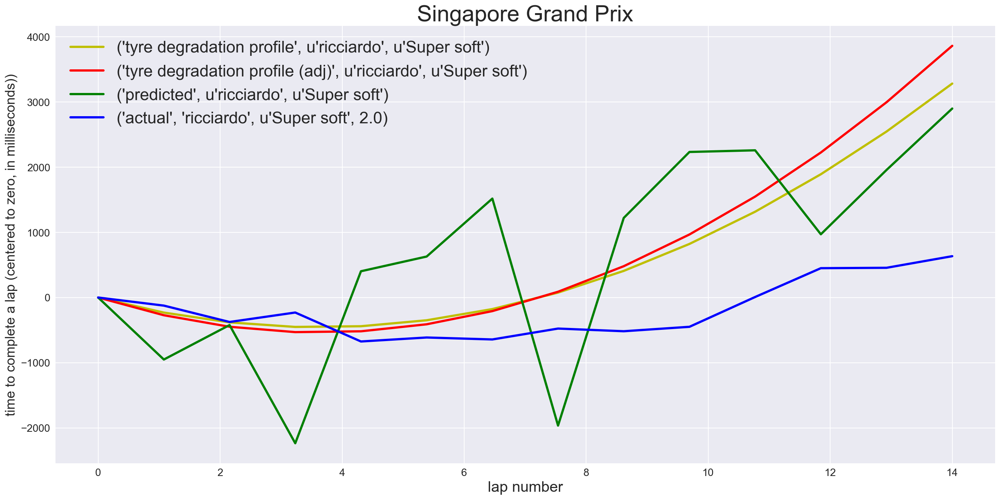

...

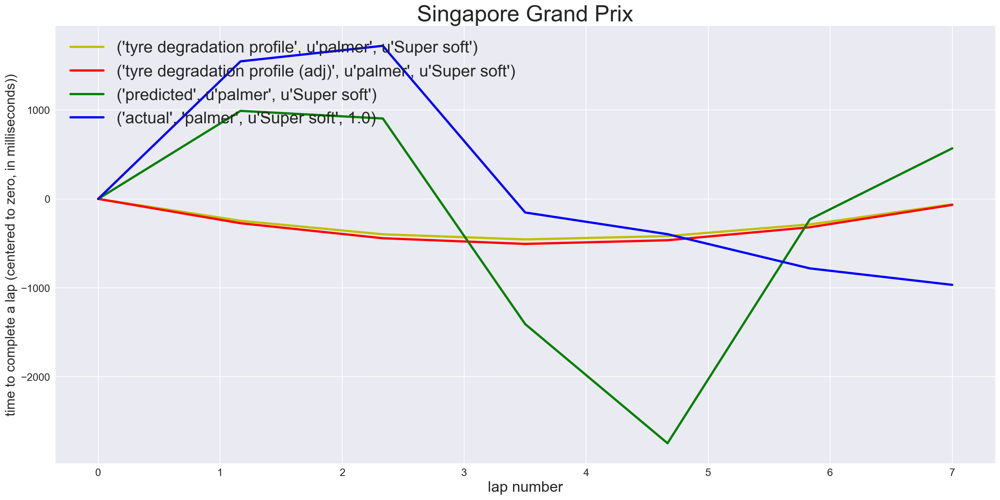

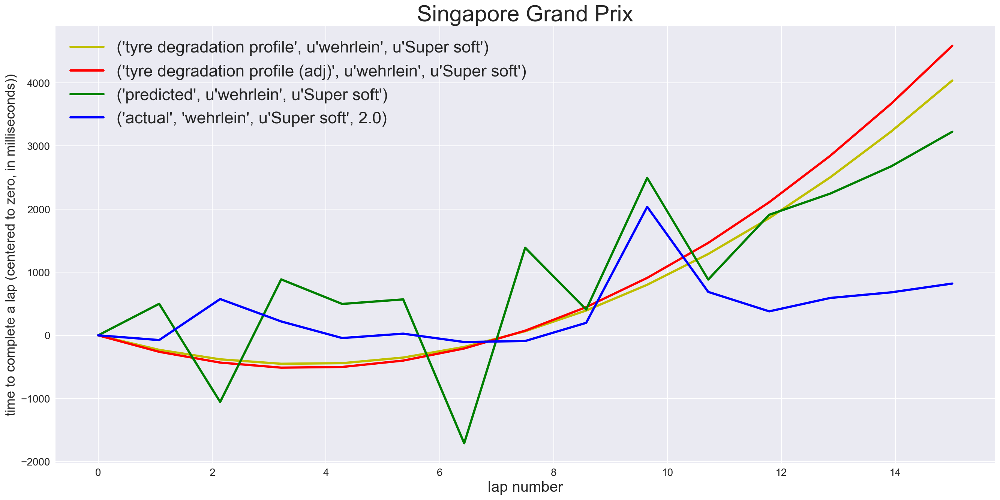

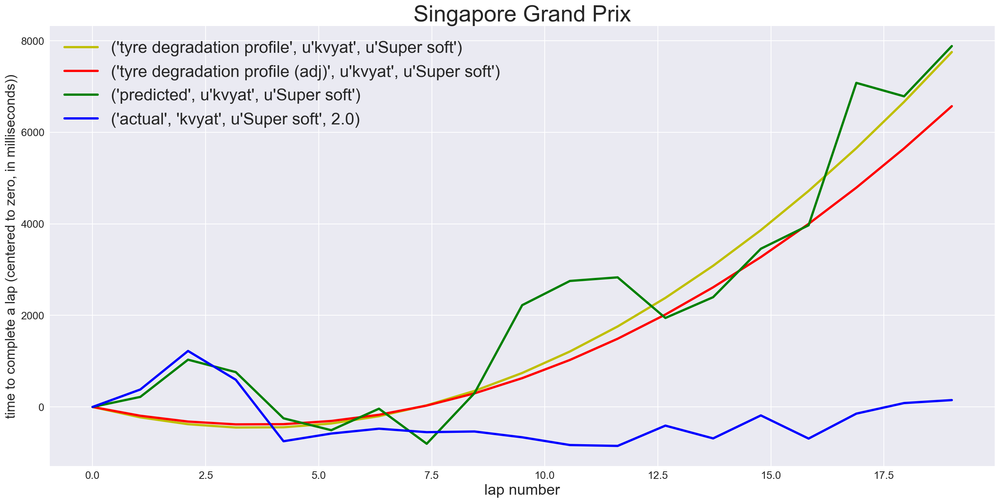

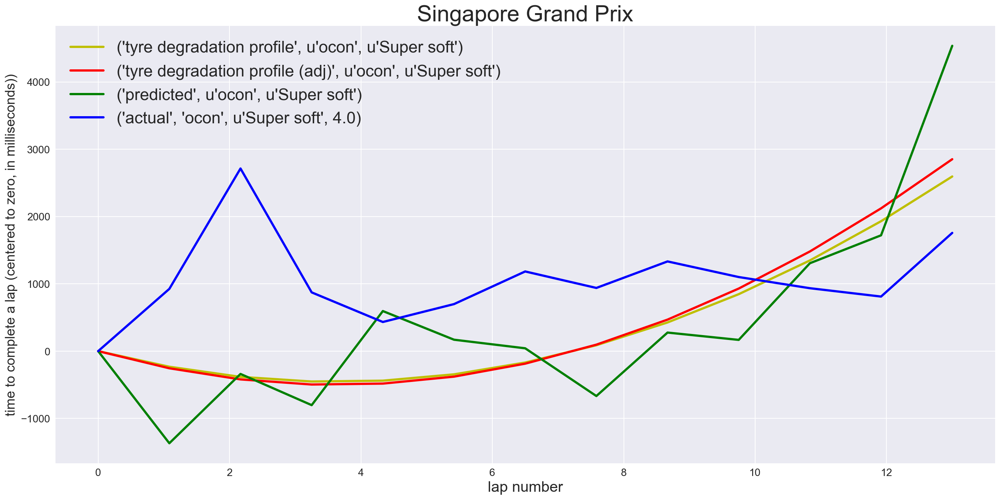

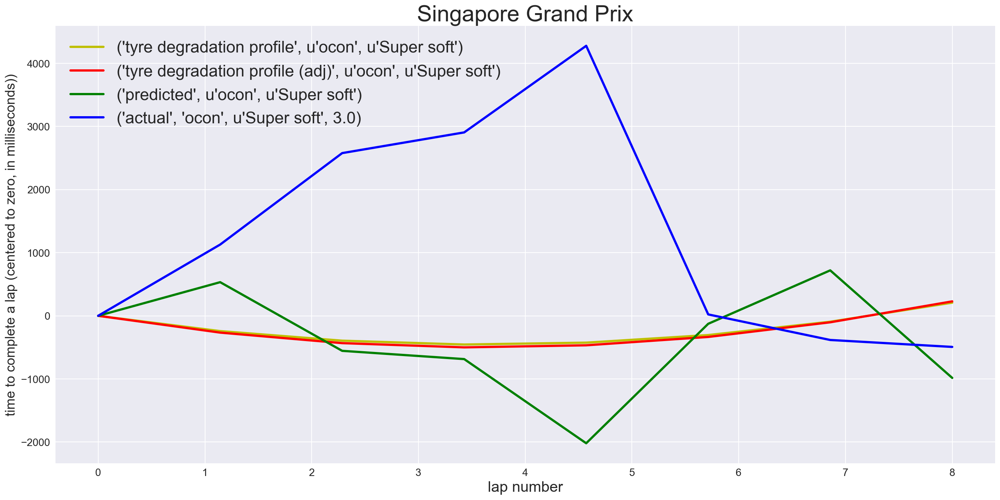

In [124]:
plot_degradation_curves_ALL(ss, sgp_test_ss, df_laptime_var_overall_2016,\
                            groupby_1_field='driverRef', groupby_2_field='name', groupby_3_field='tyre', groupby_4_field='stint')

57


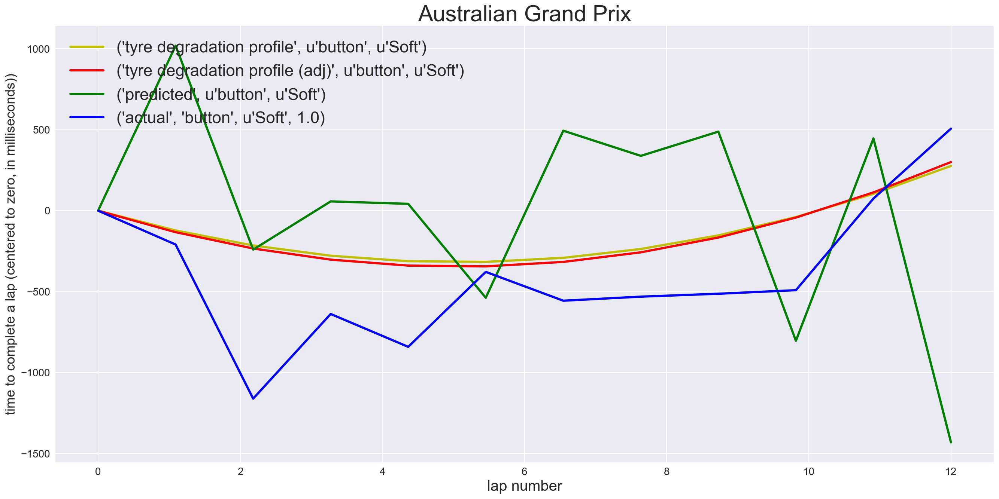

57


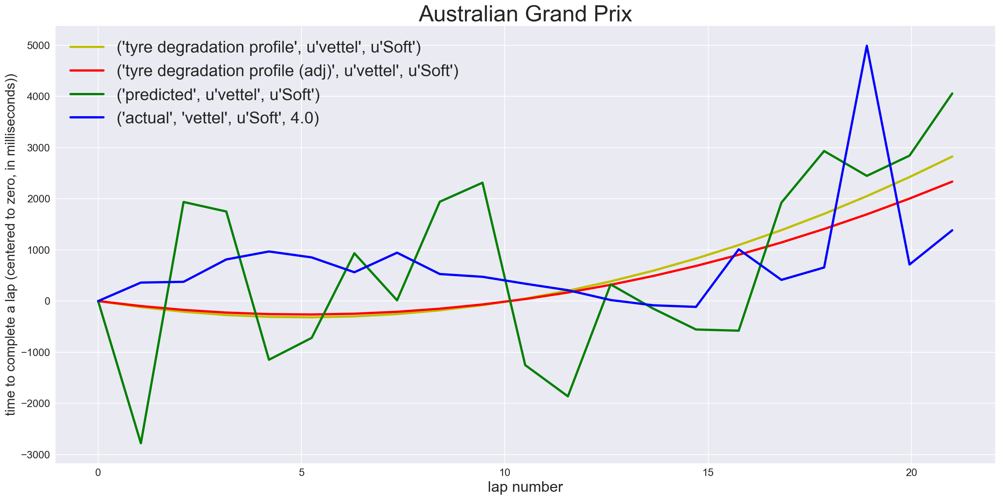

57


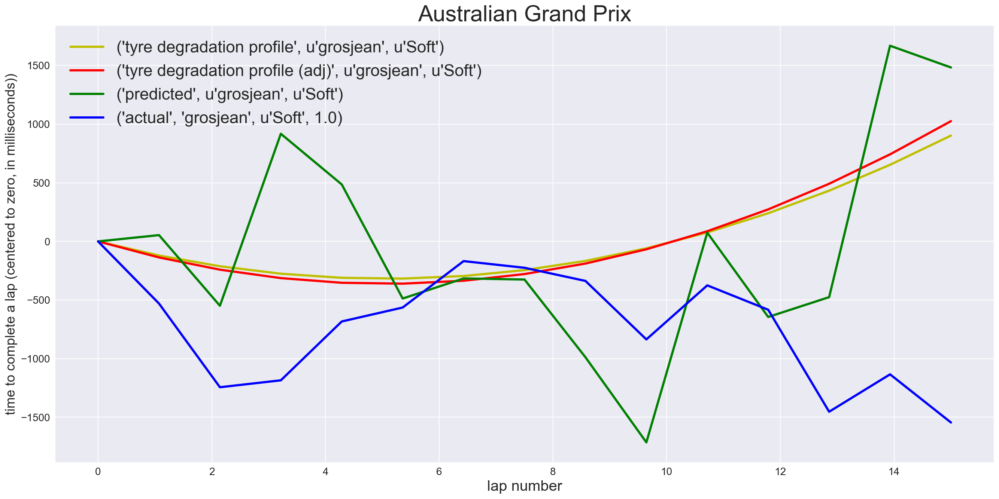

57


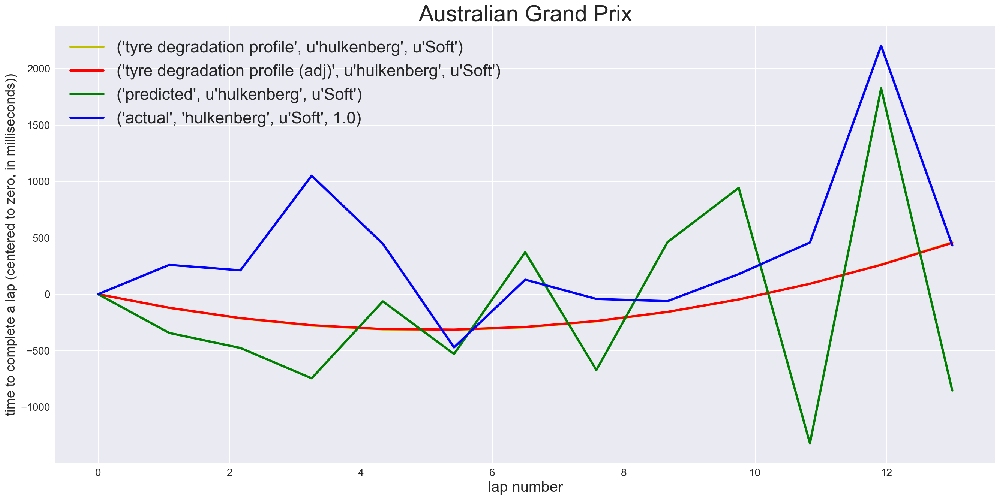

57


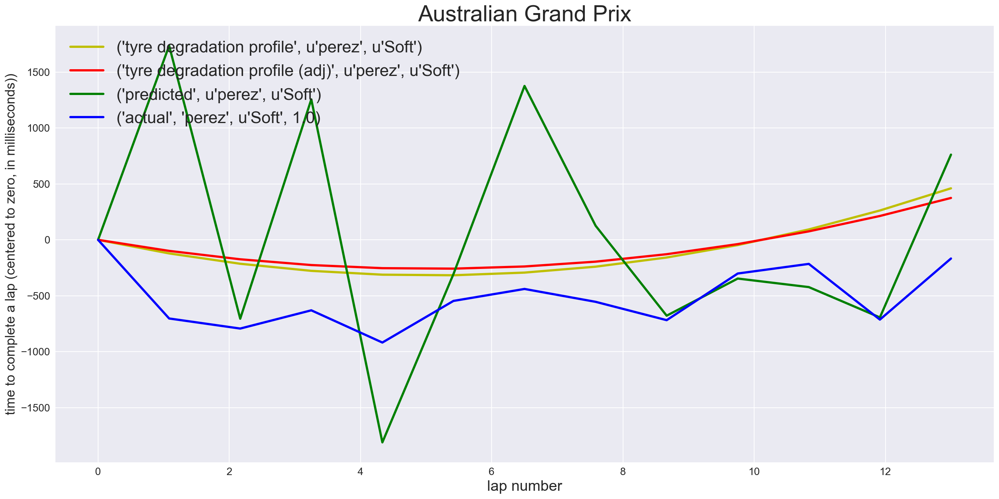

57


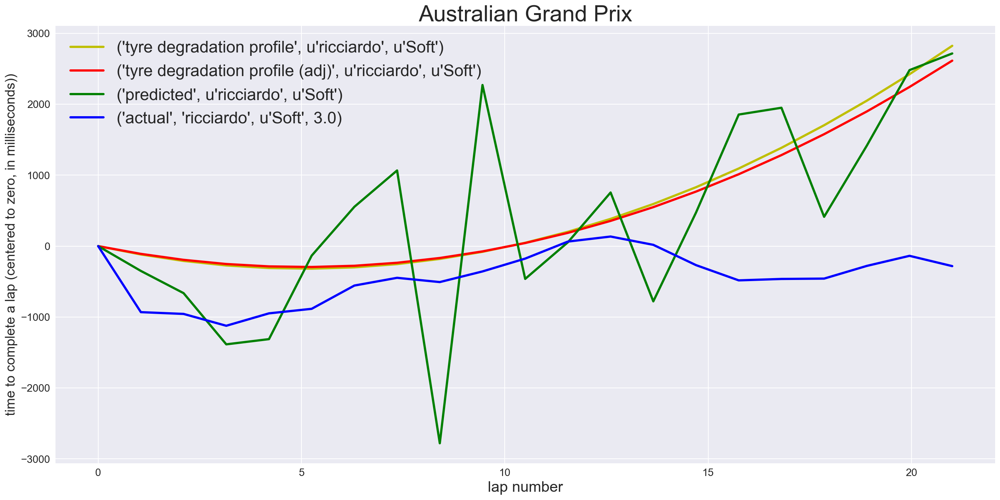

57


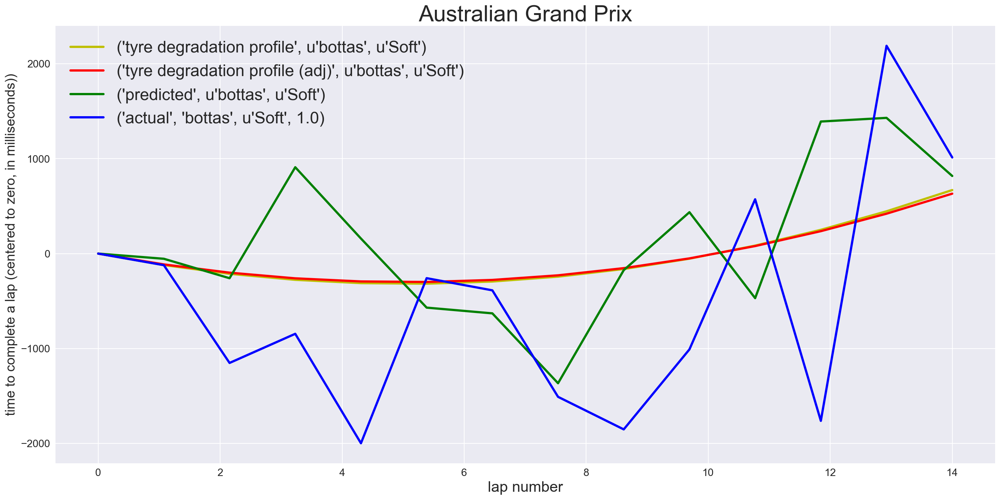

57


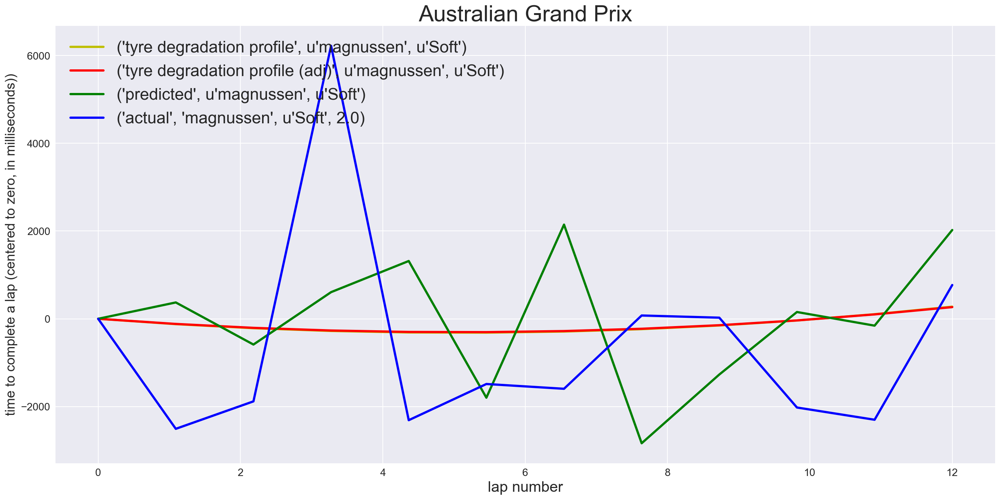

57


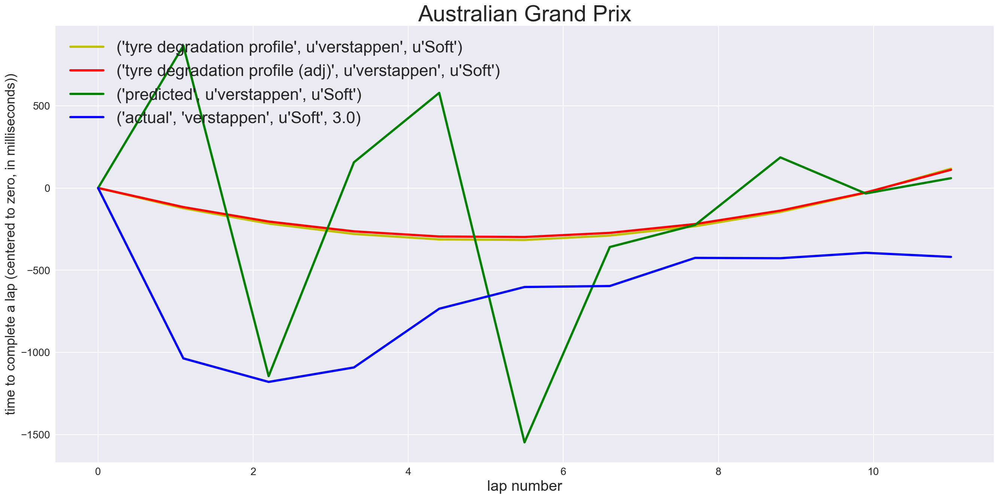

57


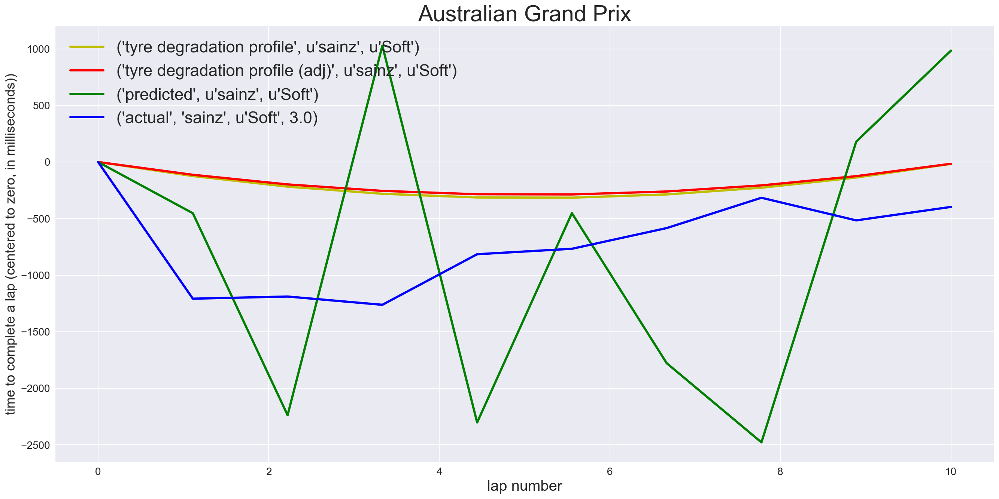

57


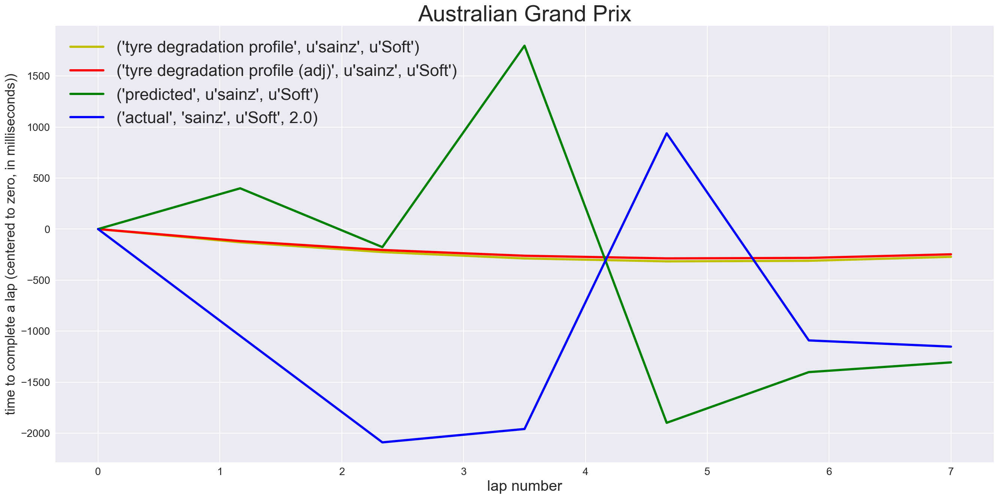

57


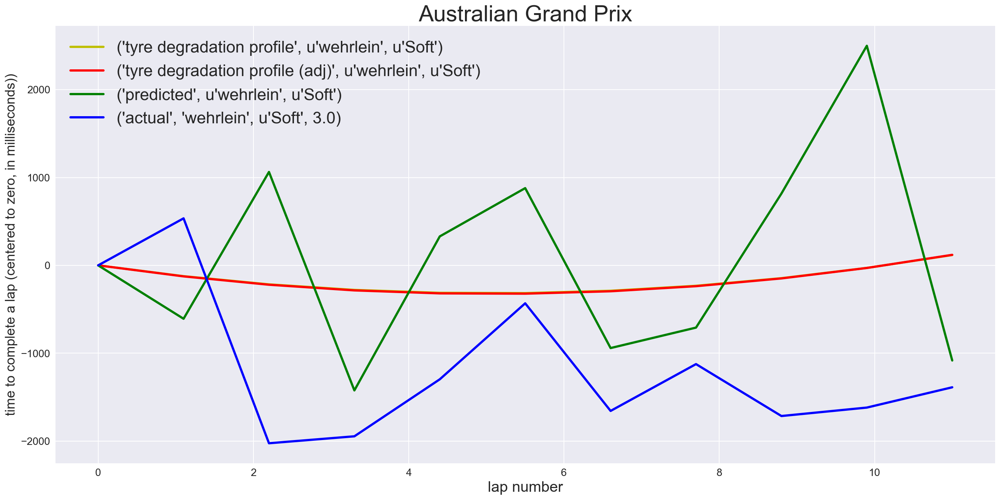

In [116]:
plot_degradation_curves_ALL(drivers_m_TYRE_r_2016, aus_test, df_laptime_var_overall_2016,\
                            groupby_1_field='driverRef', groupby_2_field='name', groupby_3_field='tyre', groupby_4_field='stint')

### Observations:
1. Some of the predicted laptimes for certain drivers: Wehleirn, Palmer, Nasr, Magnussen (Spore Grand Prix) looks to be well-fitted.
2. Adding the random variable seems to be causing large variations in predicted vs actual laptimes, even though the actual data (laptimes) is close to the baseline tyre degradation profile.
3. To evaluate laptime model fitting, next step is to calculate the R2-score to measure how close the predicted laptimes are to the actual laptimes.